# Data Mining - EDA

## 1. Importing libraries

`Step 1` Import the required libraries

In [68]:
import pandas as pd 
import numpy as np
import scipy as sc
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
import os


## 2. Data Integration

`Step 2` Use the method **.read_csv()** to import the dataset, storing it in the data frame **df** and checking the top 5 rows high **.head()** method.

In [2]:
df = pd.read_csv('DM2425_ABCDEats_DATASET.csv')
df.head()

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
0,1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,...,0,0,0,0,2,0,0,0,0,0
1,5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,0
2,f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,...,0,0,0,0,0,0,0,0,0,0
3,180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,0,0
4,4eb37a6705,4660,20.0,2,5,0,0.0,2,-,DIGI,...,0,0,0,0,0,0,0,0,0,0


### 2.1 Data Description

`customer_id:` Unique identifier for each customer. <br>
`customer_region:` Geographic region where the customer is located. <br>
`customer_age:` Age of the customer. <br>
`vendor_count:` Number of unique vendors the customer has ordered from. <br>
`product_count:` Total number of products the customer has ordered. <br>
`is_chain:` Indicates whether the customer’s order was from a chain restaurant. <br>
`first_order:` Number of days from the start of the dataset when the customer first placed an order. <br>
`last_order:` Number of days from the start of the dataset when the customer most recently placed an order. <br>
`last_promo:` The category of the promotion or discount most recently used by the customer. <br>
`payment_method:` Method most recently used by the customer to pay for their orders. <br>
`CUI_American, CUI_Asian, CUI_Chinese, CUI_Italian, etc:` The amount in monetary units spent by the customer from the indicated type of cuisine. <br>
`DOW_0 to DOW_6:` Number of orders placed on each day of the week (0 = Sunday, 6 = Saturday). <br>
`HR_0 to HR_23:` Number of orders placed during each hour of the day (0 = midnight, 23 = 11 PM).

## 3. Exploratory Data Analysis (EDA)

### 3.1. Data Content

`Step 3` Check the number of rows and columns of the data frame

In [3]:
df.shape

(31888, 56)

`Step 4` Check the features data types

In [4]:
df.dtypes

customer_id                  object
customer_region              object
customer_age                float64
vendor_count                  int64
product_count                 int64
is_chain                      int64
first_order                 float64
last_order                    int64
last_promo                   object
payment_method               object
CUI_American                float64
CUI_Asian                   float64
CUI_Beverages               float64
CUI_Cafe                    float64
CUI_Chicken Dishes          float64
CUI_Chinese                 float64
CUI_Desserts                float64
CUI_Healthy                 float64
CUI_Indian                  float64
CUI_Italian                 float64
CUI_Japanese                float64
CUI_Noodle Dishes           float64
CUI_OTHER                   float64
CUI_Street Food / Snacks    float64
CUI_Thai                    float64
DOW_0                         int64
DOW_1                         int64
DOW_2                       

### Conclusions
- The dataset contains **31888 rows and 56 columns**.
- `is_chain` is of int64 type but by the data description it seems like a binary variable (but actually it is not - need to ask the professor about this variable).

### 3.2. Missing values

`Step 5` Check the amount of missing values that exist in the dataset

In [5]:
df.isna().sum()

customer_id                    0
customer_region                0
customer_age                 727
vendor_count                   0
product_count                  0
is_chain                       0
first_order                  106
last_order                     0
last_promo                     0
payment_method                 0
CUI_American                   0
CUI_Asian                      0
CUI_Beverages                  0
CUI_Cafe                       0
CUI_Chicken Dishes             0
CUI_Chinese                    0
CUI_Desserts                   0
CUI_Healthy                    0
CUI_Indian                     0
CUI_Italian                    0
CUI_Japanese                   0
CUI_Noodle Dishes              0
CUI_OTHER                      0
CUI_Street Food / Snacks       0
CUI_Thai                       0
DOW_0                          0
DOW_1                          0
DOW_2                          0
DOW_3                          0
DOW_4                          0
DOW_5     

`Step 6` Checking if there are rows that contain missing values in the 3 variables with missing data `customer_age`, `first_order` and `HR_0`.

In [6]:
df[df[['customer_age', 'first_order', 'HR_0']].isnull().all(axis=1)]

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23


`Step 7` Checking how many rows have at least 1 missing value

In [7]:
df[df[['customer_age', 'first_order', 'HR_0']].isnull().any(axis=1)]

,customer_id,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
3,180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,...,1,0,0,0,0,0,0,0,0,0
27,8e8652bdc8,4660,NaN,2,3,2,0.0,6,DISCOUNT,DIGI,...,0,2,0,0,0,0,0,0,0,0
34,ae38da6386,8670,21.0,2,3,1,0.0,7,DELIVERY,DIGI,...,0,0,0,0,0,0,0,0,0,0
37,6137fa5620,8670,NaN,2,2,2,0.0,8,DISCOUNT,CARD,...,1,0,0,0,0,0,0,0,0,0
69,2a90e9da84,4660,NaN,2,2,1,0.0,17,-,CARD,...,0,1,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31883,f4e366c281,8670,30.0,1,1,1,NaN,0,FREEBIE,DIGI,...,0,0,0,0,0,0,0,0,0,0
31884,f6b6709018,8670,NaN,1,1,0,NaN,0,DELIVERY,DIGI,...,0,0,1,0,0,0,0,0,0,0
31885,f74ad8ce3f,8670,24.0,1,1,1,NaN,0,-,DIGI,...,0,0,0,0,0,0,0,0,0,0
31886,f7b19c0241,8670,34.0,1,1,0,NaN,0,DISCOUNT,DIGI,...,0,0,0,0,0,0,0,0,0,0


### Conclusions
- There are only missing values in 3 variables (all numeric): **custumer_age (727), first_order (106) and HR_0 (1165)**.
- There are no rows that have missing values in these 3 columns.
- The amount of rows that contain at least 1 missing value is: **1968 rows**.

### 3.3. Descriptive Statistics

`Step 8` Compute descriptive statistics for the numeric features

In [8]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
customer_age,31161.0,27.506499,7.160898,15.0,23.0,26.0,31.00,80.00
vendor_count,31888.0,3.102609,2.771587,0.0,1.0,2.0,4.00,41.00
product_count,31888.0,5.668245,6.957287,0.0,2.0,3.0,7.00,269.00
is_chain,31888.0,2.818866,3.977529,0.0,1.0,2.0,3.00,83.00
first_order,31782.0,28.478604,24.109086,0.0,7.0,22.0,45.00,90.00
last_order,31888.0,63.675521,23.226123,0.0,49.0,70.0,83.00,90.00
CUI_American,31888.0,4.880438,11.654018,0.0,0.0,0.0,5.66,280.21
CUI_Asian,31888.0,9.960451,23.564351,0.0,0.0,0.0,11.83,896.71
CUI_Beverages,31888.0,2.300633,8.479734,0.0,0.0,0.0,0.00,229.22
CUI_Cafe,31888.0,0.801163,6.427132,0.0,0.0,0.0,0.00,326.10


`Step 9` Check descriptive statistics for the categorical variables

In [9]:
df.describe(include='O')

,customer_id,customer_region,last_promo,payment_method
count,31888,31888,31888,31888
unique,31875,9,4,3
top,742ca068fc,8670,-,CARD
freq,2,9761,16748,20161


### Conclusions
#### Numeric variables
- In variable `customer_age` the minimum value is **15** years old, so we have customers that are minors. Considering the GDPR (General Data Protection Regulation), we cannot treat data of minor under 16 without parental consent (we might remove those clients in Data Pre-processing).
- The average age of our customers is **≈28 years old,** which means the company customers are mainly young adults. 
- Variables `vendor_count`, `product_count`, `is_chain`, `first_order` have as minimum value 0, which indicate that we may have customers that did not actually make any purchases in the company (so they shouldn't be considered as customers).
- On average each customer orders **5.668245 items** in a purchase.
- Asian cuisine is the type of cuisine where people spend on average the most, and is also the one where a customer spent the most money on **(896.71 monetary units)**.
- Noodle dishes cuisine is on average the type of cuisine costumers spend less monetary units in it. However, Thai cuisine is the type of cuisine where the customer who spend the most on it registered the lowest value when compared with the other types of cuisine. (Basically, Thai cuisine has the lowest maximum value).
- Friday and Saturday were the days when the highest amount of orders was placed **(20)**. Moreover, Saturday has the highest number of orders than Friday and then any other day of the week.
- The hour of the day when the most orders were registered was 8 a.m **(52 orders)**.
- There are no orders that occurred at midnight, since all the values in variable HR_0 equal 0, so this is a univariate variable (that will not help us discriminate into different customer segments).
- The top 3 hours of the day that registered more orders on average are 5p.m **(0.390962)**, 11 a.m **(0.378167)**, 4p.m **(0.356435)**.
- Variables `customer_age`, `vendor_count`, `product_count`, `is_chain`, `first_order`, all `CUI ...`, all `DOW ...` and all `HR ...` variables have a great discrepancy between the value in the 75 percentile and the maximum value, which indicates the presence of outliers in the data.
#### Categorical variables
- Variable `customer_id` has **31875** unique values out of the **31888** clients in the dataset, so this indicates that we may have duplicates in the data (13 duplicates).
- There are only 9 different customer regions where our customers belong to. Being the most common, the region 8670 with **30.61%** of the customers belonging to it.
- There are four different promotion types used by customers in the date of their last purchase. The most common one is "-", which likely indicates that no promotion was used. In fact, **52.52%** of customers did not use any promotion.
- Customers paid their bills with 3 different methods, being Card the most common, with **63.22%** of customers using it as their preferred method for payment.

### 3.4. Incoherences

`Step 10` Check the number of duplicated rows in the dataset

In [10]:
df.duplicated().sum()

13

`Step 10.1` Drop the duplicates in the dataset

In [11]:
# Drop the duplicates in the df
df.drop_duplicates(inplace=True)
# Print the current number of duplicates in df to if the code worked
df.duplicated().sum()

0

`Step 10.2` Setting the `customer_id` as index.

In [12]:
df.set_index('customer_id', inplace=True)
df.head()

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,2360,18.0,2,5,1,0.0,1,DELIVERY,DIGI,0.00,...,0,0,0,0,2,0,0,0,0,0
5d272b9dcb,8670,17.0,2,2,2,0.0,1,DISCOUNT,DIGI,12.82,...,0,0,0,0,0,0,0,0,0,0
f6d1b2ba63,4660,38.0,1,2,2,0.0,1,DISCOUNT,CASH,9.20,...,0,0,0,0,0,0,0,0,0,0
180c632ed8,4660,NaN,2,3,1,0.0,2,DELIVERY,DIGI,0.00,...,1,0,0,0,0,0,0,0,0,0
4eb37a6705,4660,20.0,2,5,0,0.0,2,-,DIGI,14.57,...,0,0,0,0,0,0,0,0,0,0


`Step 11` Check the number of customers whose value in `first_order` is 0

In [13]:
len(df[df["first_order"]==0])

1436

`Step 11.1` Checking if the total number of customers that did not register any first order also have a value different than 0 in the variable `last_order` 

In [14]:
len(df[(df["first_order"] == 0) & (df["last_order"] != 0)])

1436

`Step 11.2` Checking if the value in `last_order` is lower than the value in `first_order`

In [15]:
df[(df['last_order'] < df['first_order'])][["first_order","last_order"]]

,first_order,last_order
customer_id,,


`Step 12` Checking if we have been customers that did not spend any money while having `first_order` and `last_order` column value equal to 0 (If any row falls into these criteria, then we would have non-customers in the dataset).

In [16]:
cuisine_columns = [
    "CUI_American", 
    "CUI_Asian", 
    "CUI_Beverages", 
    "CUI_Cafe", 
    "CUI_Chicken Dishes", 
    "CUI_Chinese", 
    "CUI_Desserts", 
    "CUI_Healthy", 
    "CUI_Indian", 
    "CUI_Italian", 
    "CUI_Japanese", 
    "CUI_Noodle Dishes", 
    "CUI_OTHER", 
    "CUI_Street Food / Snacks", 
    "CUI_Thai"
]

# Filter DataFrame
df[
    (df["first_order"] == 0) & 
    (df["last_order"] == 0) & 
    (df[cuisine_columns] != 0).any(axis=1)
] # Our dataset only contains actual customers!

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,


`Step 13` Checking if there are customers that have no spendings in all columns of cuisine.

In [17]:
df[(df[cuisine_columns] == 0).all(axis=1)][cuisine_columns]

,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
customer_id,,,,,,,,,,,,,,,
4903041977,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
c94b288475,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
f687717dc1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
c6cf0b76fb,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1b7c34738e,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0039059c9c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
0e60632fe2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


`Step 13.1` Checking if there are rows where no money was spent in any type of cuisine, and no amount of order was registered

In [18]:
dow_columns = ["DOW_0", "DOW_1", "DOW_2", "DOW_3", "DOW_4", "DOW_5", "DOW_6"]
hr_columns = ["HR_" + str(i) for i in range(24)]
all_columns = cuisine_columns + dow_columns + hr_columns

df[(df[all_columns] == 0).all(axis=1)][all_columns]

,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
4903041977,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
c94b288475,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
f687717dc1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
c6cf0b76fb,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1b7c34738e,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177ede2420,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
0039059c9c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
0e60632fe2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0


`Step 14` Checking the values in `customer_region` looking for incoherences

In [19]:
df["customer_region"].value_counts()

customer_region
8670    9761
4660    9550
2360    8829
2440    1483
4140     857
8370     495
2490     445
-        442
8550      13
Name: count, dtype: int64

`Step 15` Checking the values in `last_promo` looking for incoherences

In [20]:
df["last_promo"].value_counts(normalize=True)

last_promo
-           0.525302
DELIVERY    0.197082
DISCOUNT    0.141051
FREEBIE     0.136565
Name: proportion, dtype: float64

`Step 16` Checking the values in `payment_method` looking for incoherences

In [21]:
df["payment_method"].value_counts(normalize=True)

payment_method
CARD    0.632251
DIGI    0.191310
CASH    0.176439
Name: proportion, dtype: float64

### Conclusions
- There were indeed **13 duplicates** in the data, there were removed.
- From the **31888 customers**, **1436** customers placed the first and only order in the first day the dataset was created, since they have 0 as the value of the first purchase and last purchase.
- There are **138 customers** that did not spend any money in the company.
- Those **138 customers** actually didn't order anything. (Probs remove them in Data Pre-processing)
- There are **442 customers** that belong to region "-" (which clearly is an unknown region)
- For **52.52%** of the customer's their last promotion used was "-" so maybe we should consider it as NO Promotion used.

### 3.5. Univariate feature exploration

`Step 17` Create 2 variables `numeric_features` and `categorical_features` that store the columns that represent numeric and categorical features respectively.

In [104]:
numeric_features = ["customer_age", "vendor_count", "product_count", "first_order", "last_order"] + all_columns

categorical_features = ["is_chain", "last_promo", "payment_method", "customer_region"]

#### Univariate Numeric feature analysis

`Step 18` Check the histograms of all numeric features

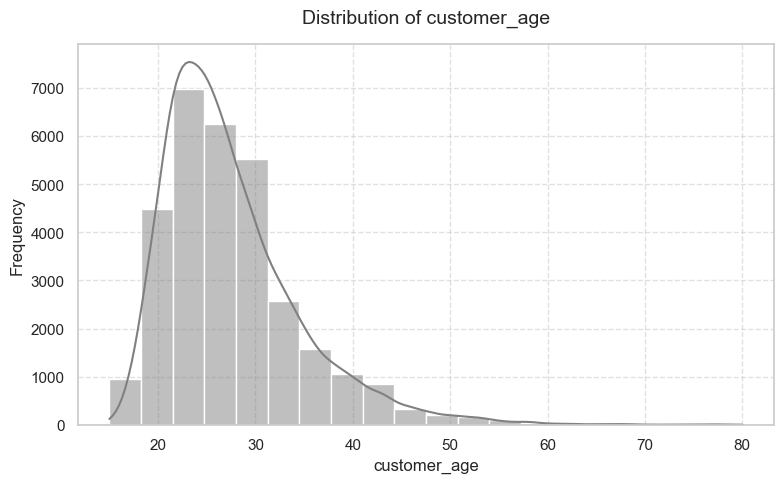

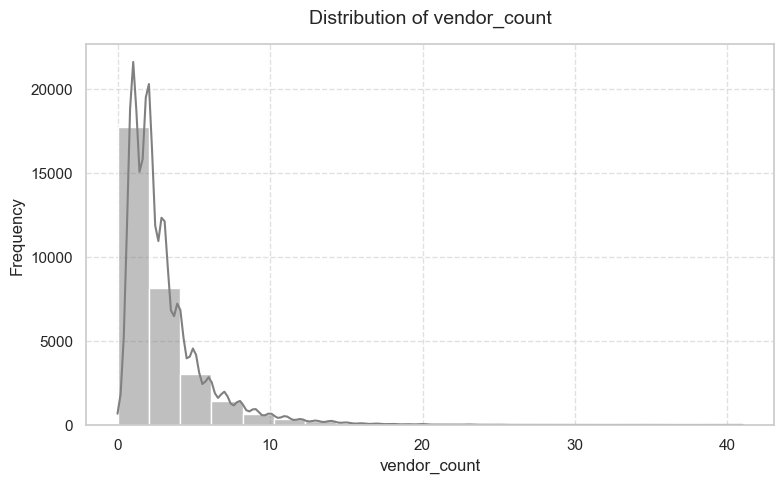

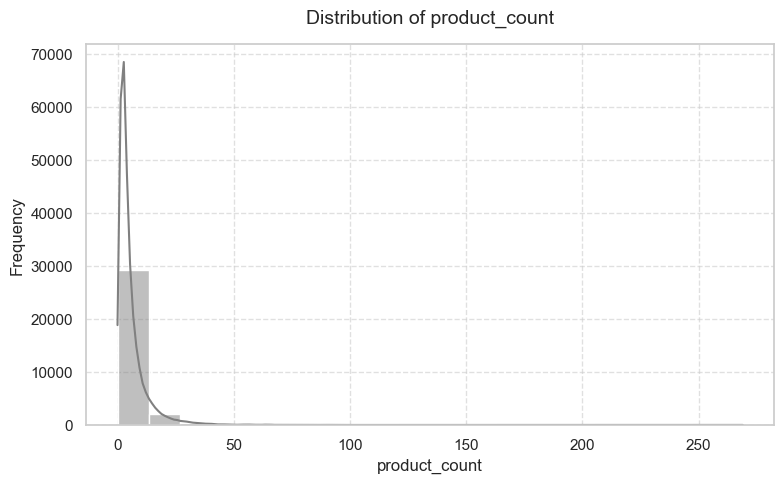

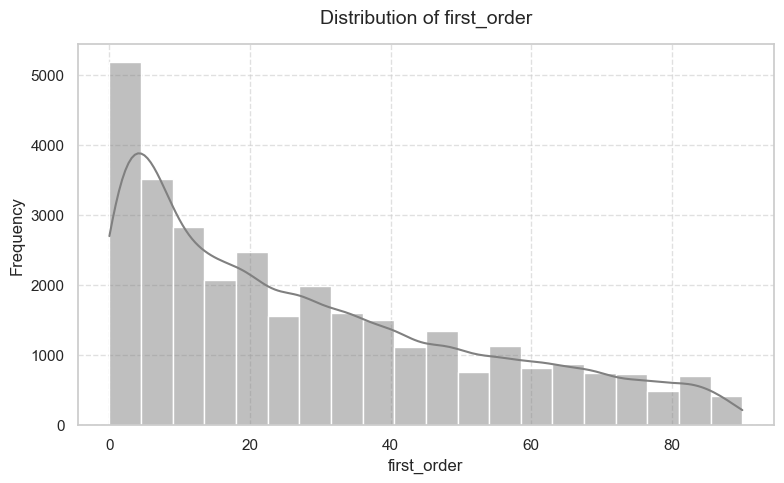

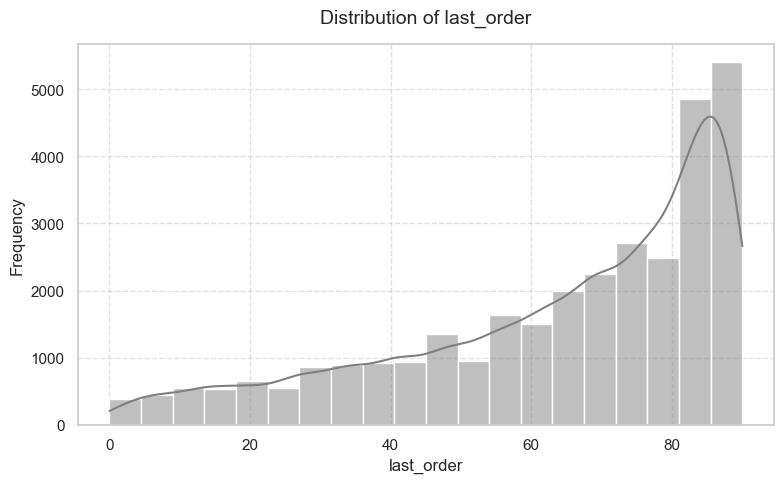

...

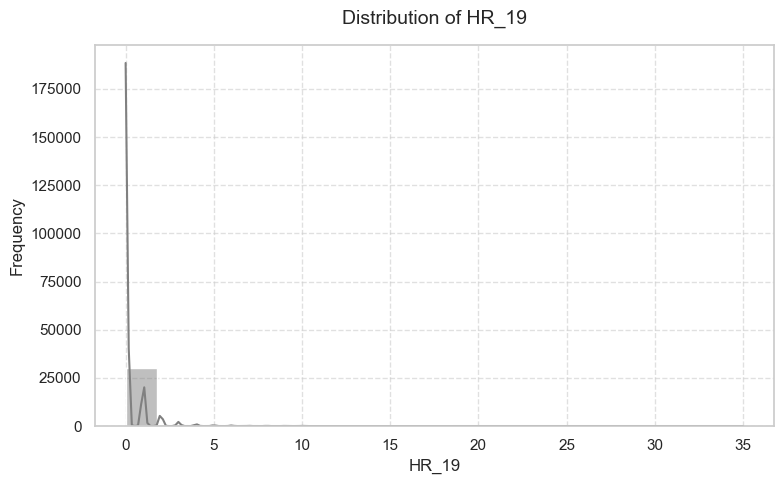

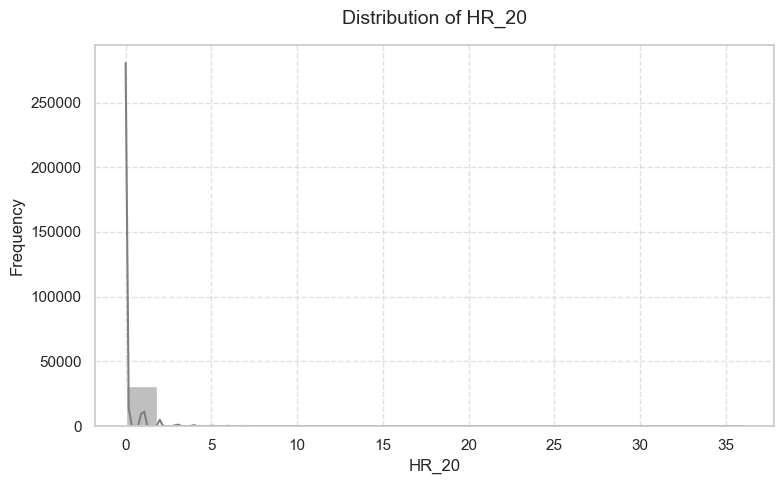

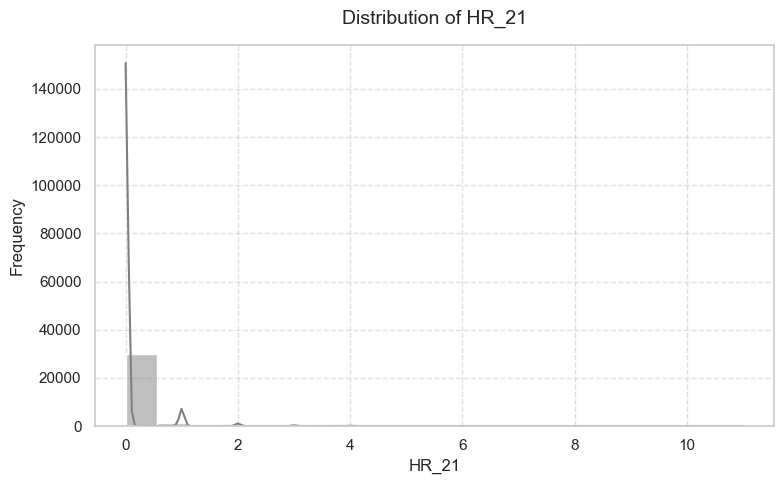

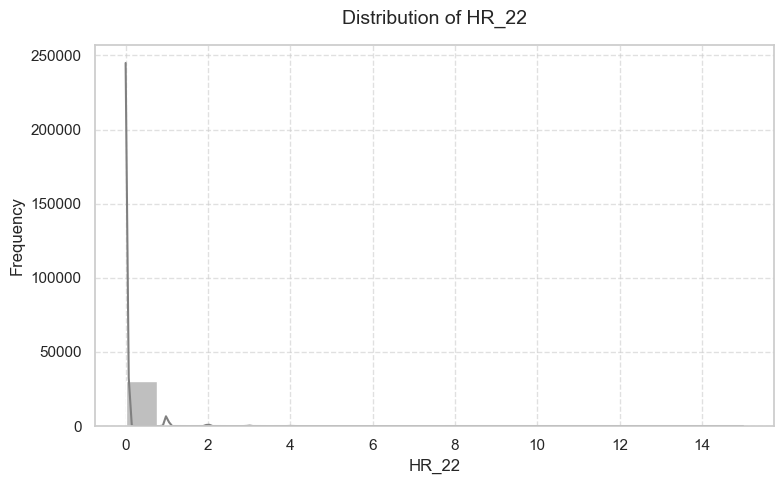

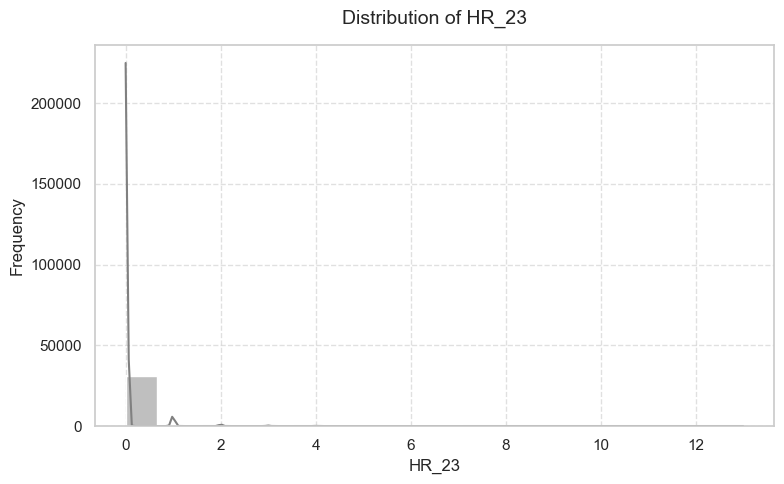

In [23]:
sns.set(style="whitegrid")

# Loop through each numeric feature
for val in numeric_features:
    plt.figure(figsize=(8, 5))  # Set figure size for each plot
    sns.histplot(df[val], bins=20, kde=True, color='gray')  # Use seaborn for a better look, add KDE for smooth curve
    plt.title(f"Distribution of {val}", fontsize=14, pad=15)  # Adjust title font size and padding
    plt.xlabel(val, fontsize=12)  # Set x-axis label
    plt.ylabel('Frequency', fontsize=12)  # Set y-axis label
    plt.grid(True, linestyle='--', alpha=0.6)  # Add grid lines with light transparency
    plt.tight_layout()  # Ensure no overlap
    plt.show()  # Display the plot

`Step 18.1` Check if with a different number of bins `customer_age` distribution resembles a normal distribution

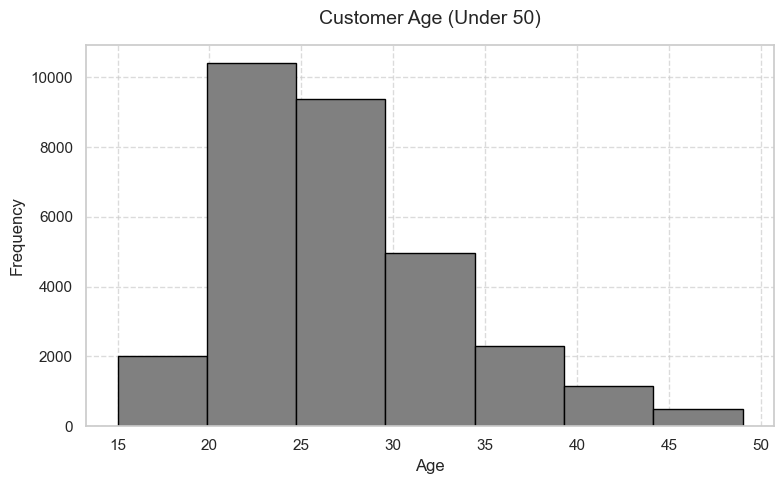

In [24]:
# Set the overall plot style for a cleaner look
sns.set(style="whitegrid")

# Experiment with bins and adjust plot properties
plt.figure(figsize=(8, 5))  # Set figure size for better readability
plt.hist(df[df["customer_age"] < 50]["customer_age"], bins=7, color='grey', edgecolor='black')  # Adjust bins and colors
plt.title("Customer Age (Under 50)", fontsize=14, pad=15)  # Title with larger font and padding
plt.xlabel("Age", fontsize=12)  # Label for x-axis
plt.ylabel("Frequency", fontsize=12)  # Label for y-axis
plt.grid(True, linestyle='--', alpha=0.7)  # Grid lines with transparency
plt.tight_layout()  # Ensure no overlap

plt.show()

`Step 18.2` Performing the Anderson-Darling test to check if the distribution of `customer_age` is normal

In [25]:
# Remove missing values
df_clean = df.dropna(subset=['customer_age'])

# Anderson-Darling test
result = stats.anderson(df_clean['customer_age'], dist='norm')

# Print the results for specific significance levels
print(f'Statistic: {result.statistic}')

# Only print results for 1%, 2.5%, and 5%
sig_levels_to_check = [1.0, 2.5, 5.0]
for i in range(len(result.critical_values)):
    sig_level = result.significance_level[i]
    if sig_level in sig_levels_to_check:
        critical_value = result.critical_values[i]
        if result.statistic < critical_value:
            print(f'At {sig_level}%, the data is likely normal (fail to reject H0)')
        else:
            print(f'At {sig_level}%, the data is likely not normal (reject H0)')

Statistic: 760.2215370066733
At 5.0%, the data is likely not normal (reject H0)
At 2.5%, the data is likely not normal (reject H0)
At 1.0%, the data is likely not normal (reject H0)


`Step 18.3` Checking if the distribution of `customer_age` is a normal distribution without outliers

In [26]:
# Step 1: Calculate the IQR for customer_age
Q1 = df_clean['customer_age'].quantile(0.25)
Q3 = df_clean['customer_age'].quantile(0.75)
IQR = Q3 - Q1

# Step 2: Define the bounds for detecting outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Step 3: Remove outliers from the data
df_no_outliers = df_clean[(df_clean['customer_age'] >= lower_bound) & (df_clean['customer_age'] <= upper_bound)]

# Step 4: Perform the Anderson-Darling test for normality
result = stats.anderson(df_no_outliers['customer_age'], dist='norm')

# Print the test statistic
print(f'Statistic: {result.statistic}')

# Only print results for 1%, 2.5%, and 5% significance levels
sig_levels_to_check = [1.0, 2.5, 5.0]
for i in range(len(result.critical_values)):
    sig_level = result.significance_level[i]
    if sig_level in sig_levels_to_check:
        critical_value = result.critical_values[i]
        if result.statistic < critical_value:
            print(f'At {sig_level}%, the data is likely normal (fail to reject H0)')
        else:
            print(f'At {sig_level}%, the data is likely not normal (reject H0)')

Statistic: 402.53525277586596
At 5.0%, the data is likely not normal (reject H0)
At 2.5%, the data is likely not normal (reject H0)
At 1.0%, the data is likely not normal (reject H0)


`Step 19` Checking the box plot of all the numeric variables

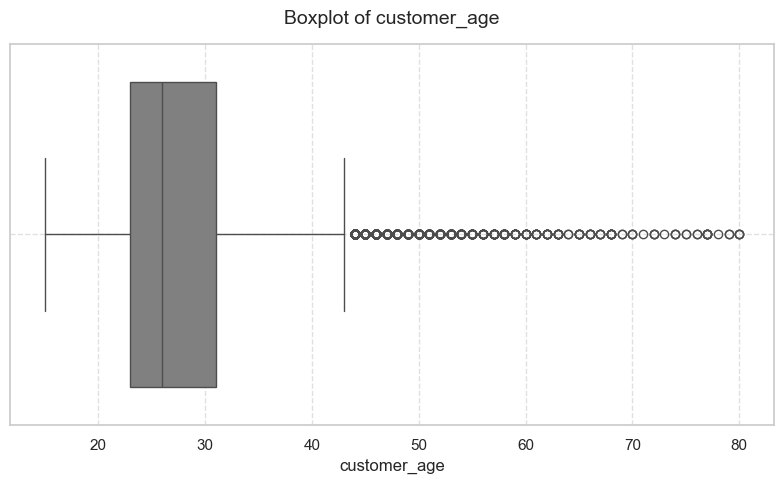

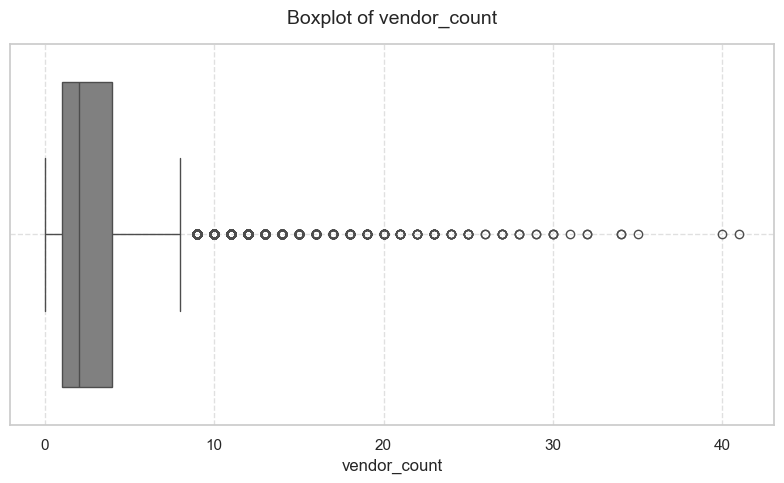

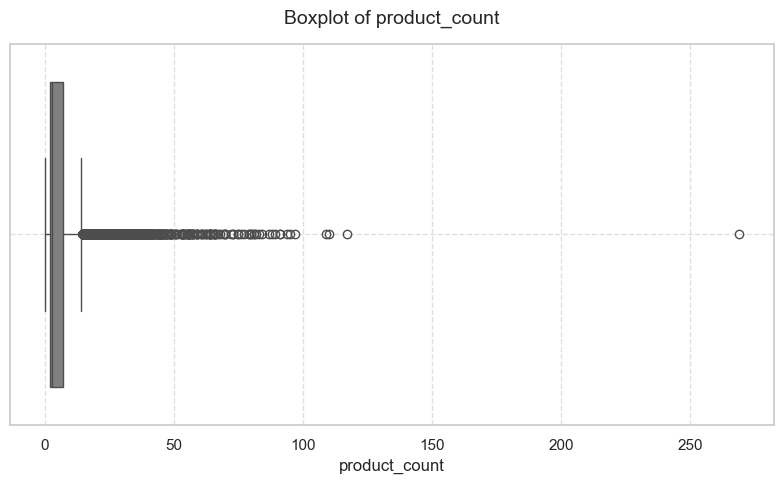

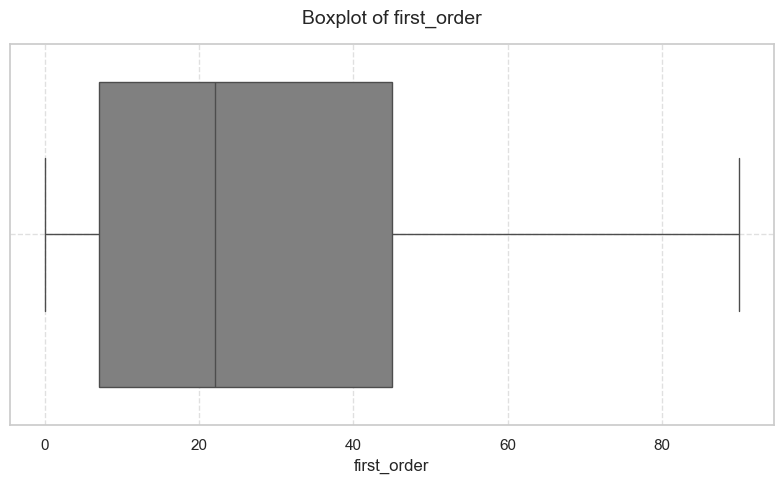

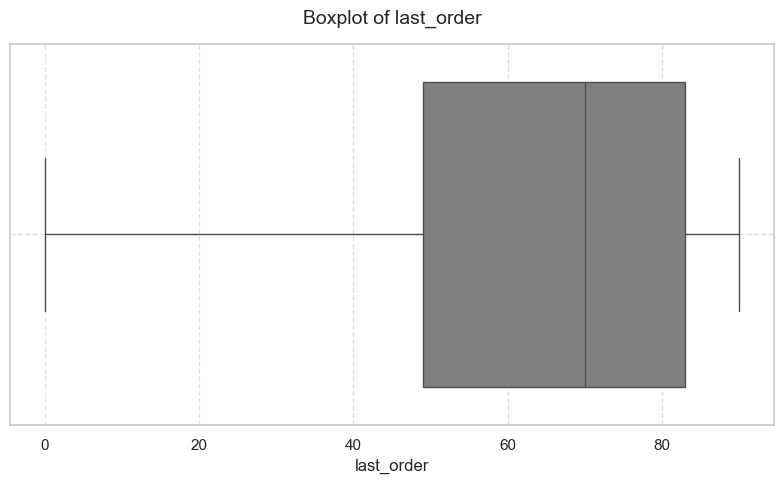

...

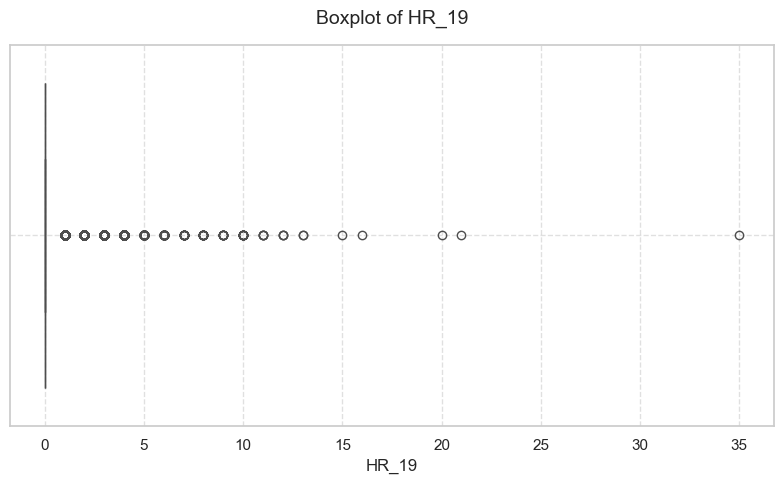

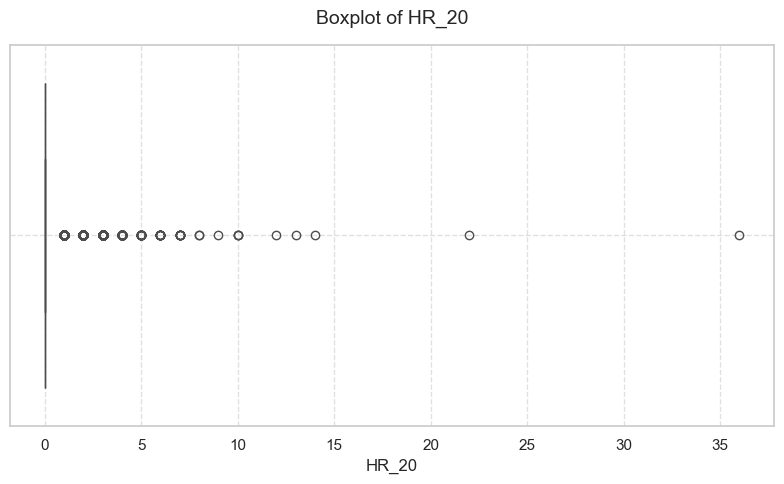

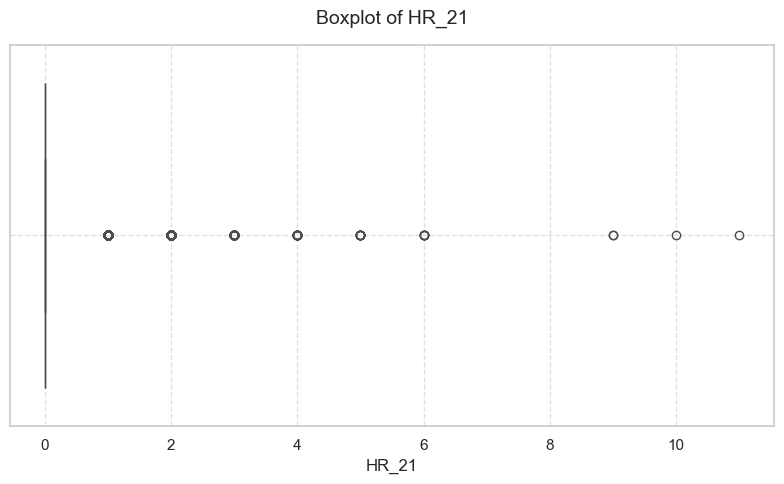

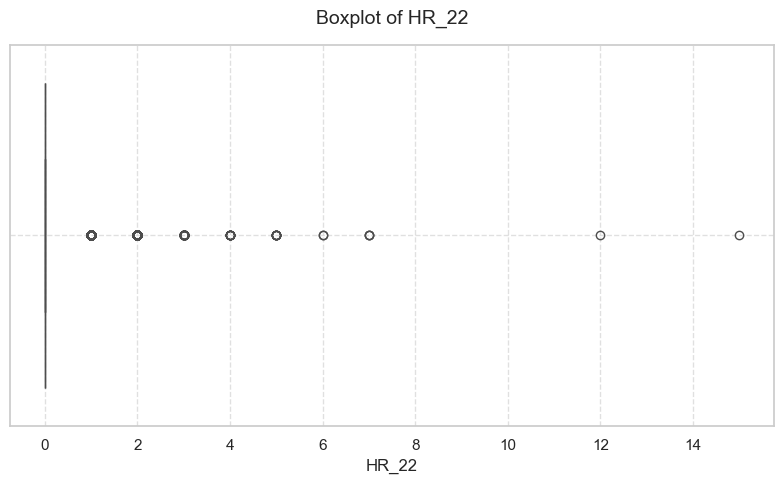

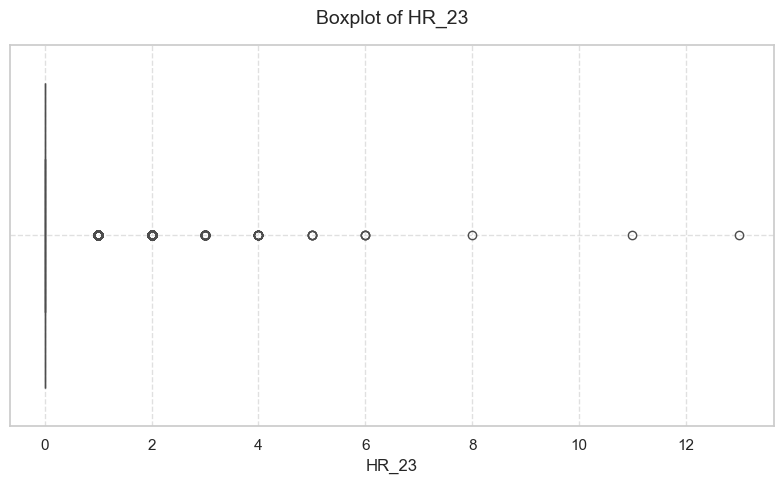

In [27]:
sns.set(style="whitegrid")

# Loop through each numeric feature to create boxplots
for val in numeric_features:
    plt.figure(figsize=(8, 5))  # Set figure size for each plot
    sns.boxplot(x=df[val], color='gray')  # Create boxplot with specified color
    plt.title(f"Boxplot of {val}", fontsize=14, pad=15)  # Adjust title font size and padding
    plt.xlabel(val, fontsize=12)  # Set x-axis label
    plt.grid(True, linestyle='--', alpha=0.6)  # Add grid lines with light transparency
    plt.tight_layout()  # Ensure no overlap
    plt.show()

#### Categorical Univariate Analysis

`Step 20` Checking the bar plot of all categorical features

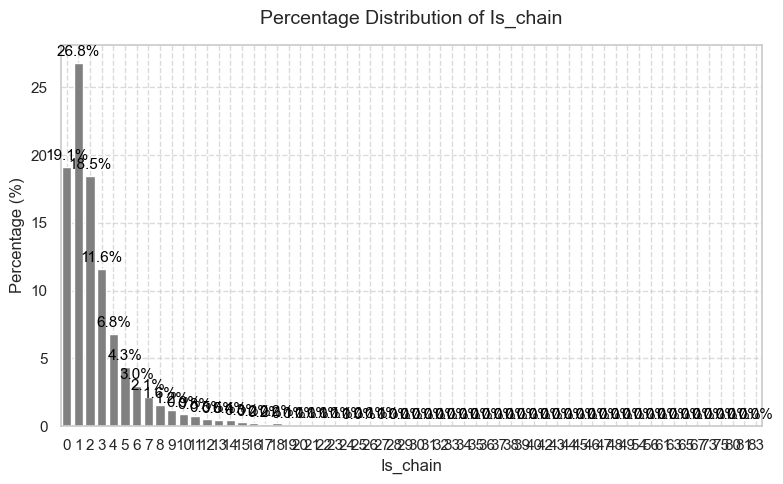

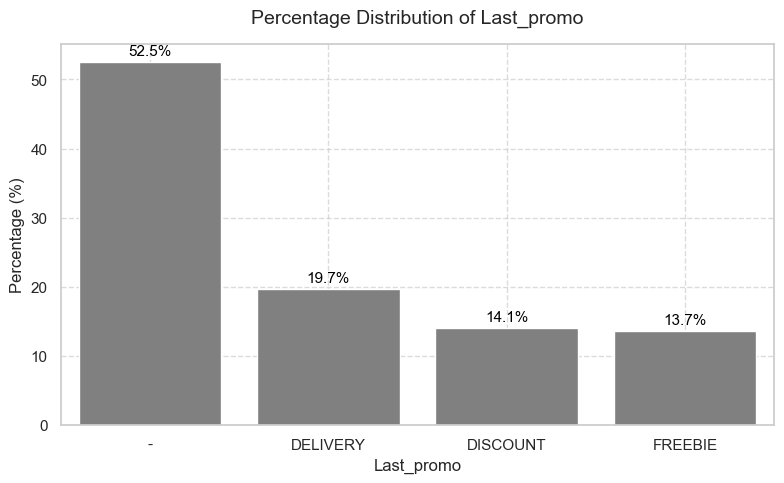

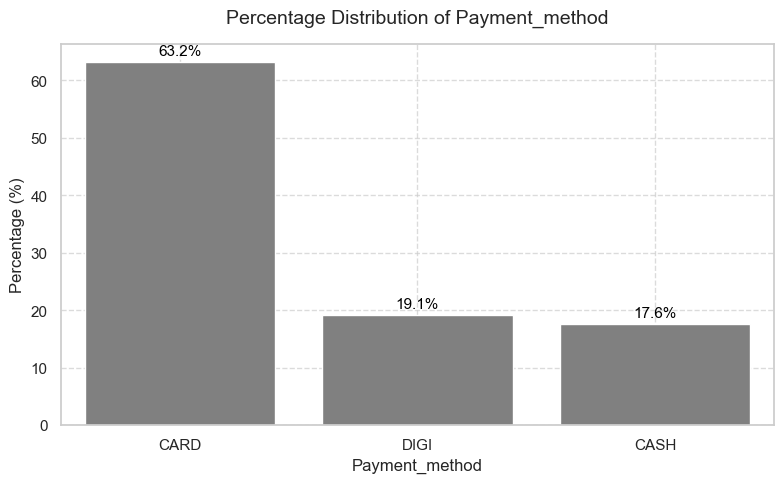

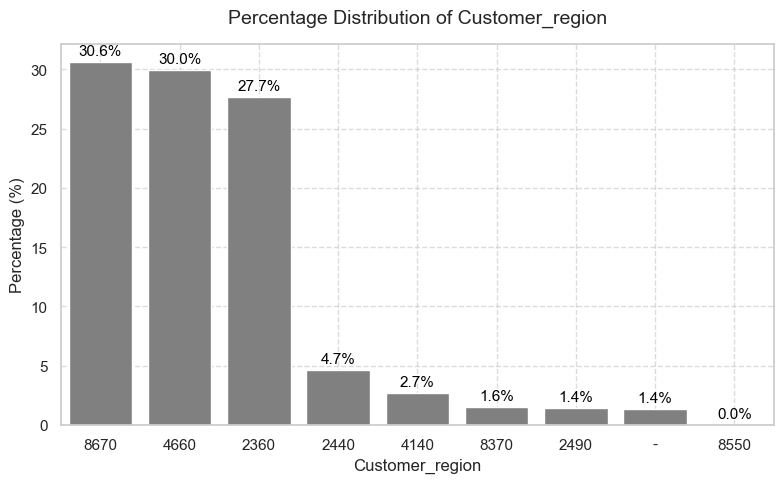

In [106]:
# Set the overall plot style for a cleaner look
sns.set(style="whitegrid")

# Iterate through each categorical feature to create bar plots with percentage on the y-axis
for feature in categorical_features:
    plt.figure(figsize=(8, 5))  # Set figure size for each plot
    
    # Calculate the percentage for each category
    percentage = df[feature].value_counts(normalize=True) * 100
    
    # Create the bar plot, setting the y values as percentage
    ax = sns.barplot(x=percentage.index, y=percentage.values, color="gray")
    
    # Annotate each bar with the percentage
    for p in ax.patches:
        ax.annotate(f'{p.get_height():.1f}%',  # Format to 1 decimal place
                    (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha='center', va='baseline', fontsize=11, color='black', 
                    xytext=(0, 5), textcoords='offset points')

    # Set the plot title and axis labels
    plt.title(f"Percentage Distribution of {feature.capitalize()}", fontsize=14, pad=15)  # Title with larger font and padding
    plt.xlabel(feature.capitalize(), fontsize=12)  # Label for x-axis
    plt.ylabel("Percentage (%)", fontsize=12)  # Label for y-axis
    plt.grid(True, linestyle='--', alpha=0.7)  # Grid lines with transparency
    
    plt.tight_layout()  # Ensure no overlap
    plt.show()  # Display the plot

### Conclusions
#### Numeric features
- From our set of features, `customer_age` is the one whose distribution resembles the most, a normal distribution, despite its long tail in the right.
- After performing the Anderson-Darling to check if the distribution of the variable is Normal, we concluded that for all usual significance levels the distribution is not a normal one. (We strongly reject that hypothesis!)
- Even if we remove the outliers from the distribution, the distribution is not Normal.
- As expected, while `first order` possesses a right skewed distribution, `last_order` possesses a left skewed distribution (being the only one with this kind of distribution.
- All other variables have right skewed distributions.
- The vast majority of our variables possess outliers, the ones that don't have outliers are: `first_order`, `last_order` and `HR_0`.
- The variable `HR_0` only possesses values equal to 0, which might change in the data pre-processing.
### Categorical features
- **Warning:** I still have doubts if `is_chain` should be a binary or a categorical variable (like a chain code). Nonetheless, by analysing the bar plot, we can see that the values from 0 to 3 encapsulate **71%** of the customers.
- The most used promotion was **"Delivery"** (considering "-" as not using a promotion) with **19.7%**, followed by **"Discount"** with **14.1%** of the customers using it and then not using **"Freebie"** with **13.7%**. It seems there is a clear promotion which is mostly adopted by the customers.
- Regarding the different `Payment_methods` the most preferred one is **"Card"** with **63.2%** indicating that the majority of our customers prefer to pay their build with their credit cards.
- **88.3%** of our customers are located in 3 of the 8 regions, which indicates that our customer base is highly concentrated in just **37.5%** of the possible regions. Focusing markerting on the other small represented regions can be a good solution to increase the company customer base in these regions
- The regions where our customer base is the largest are: region 8670 with **30.6%** of the customers belonging to this region, region 4660 with **30%** of the customers belonging to this region and region 2360 with **27.7%** of the customers belonging to this region.

### 3.6. Additional features exploration

`Step 21` Create a variable called 'order_lifetime' that stores the difference between the `last_order` and `first_order`

In [29]:
df['order_lifetime'] = df['last_order'] - df['first_order']
df['order_lifetime'].value_counts()

order_lifetime
0.0     7187
49.0     372
77.0     366
56.0     363
84.0     346
        ... 
19.0     212
11.0     202
88.0     173
89.0     131
90.0       2
Name: count, Length: 91, dtype: int64

`Step 21.1` Check the histogram of varaible *order_lifetime*.

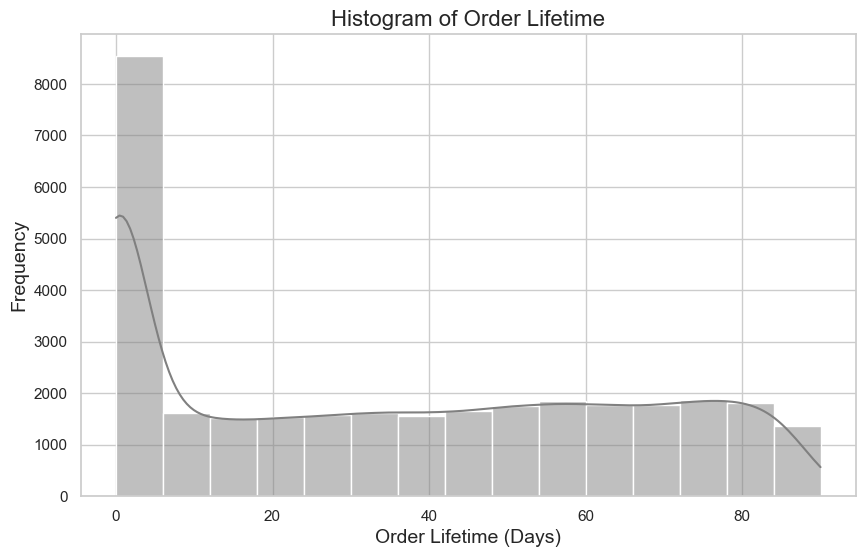

In [30]:
# Set the seaborn style to whitegrid
sns.set(style="whitegrid")

# Create a histogram of the 'order_lifetime' (or any other variable name you used)
plt.figure(figsize=(10, 6))  # Adjust the size of the plot if necessary

# Use a more appealing color like 'skyblue' or any other seaborn color palette
sns.histplot(df['order_lifetime'], bins=15, kde=True, color='grey')

# Add labels and title
plt.title('Histogram of Order Lifetime', fontsize=16)
plt.xlabel('Order Lifetime (Days)', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

# Show the plot
plt.show()

`Step 22.2` Check the histogram for values higher than 0

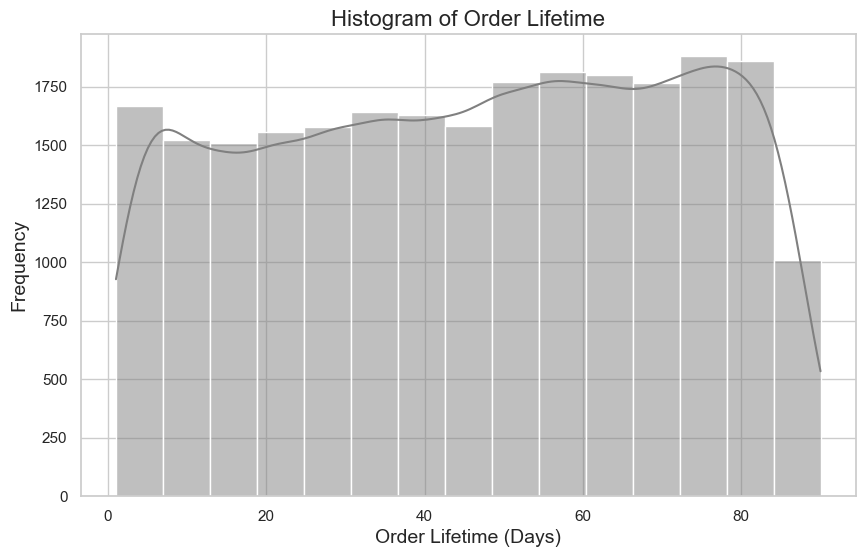

In [31]:
df_filtered = df[df['order_lifetime'] > 0]

# Set the seaborn style to whitegrid
sns.set(style="whitegrid")

# Create a histogram of 'order_lifetime' where values are greater than 0, overlay KDE
plt.figure(figsize=(10, 6))  # Adjust the size of the plot if necessary

# Use grey for the histogram and show both the histogram and KDE (Kernel Density Estimate)
sns.histplot(df_filtered['order_lifetime'], bins=15, kde=True, color='grey')

# Add labels and title
plt.title('Histogram of Order Lifetime', fontsize=16)
plt.xlabel('Order Lifetime (Days)', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

# Show the plot
plt.show()

`Step 22.2` Ploting the boxplot of the variable *order_lifetime*.

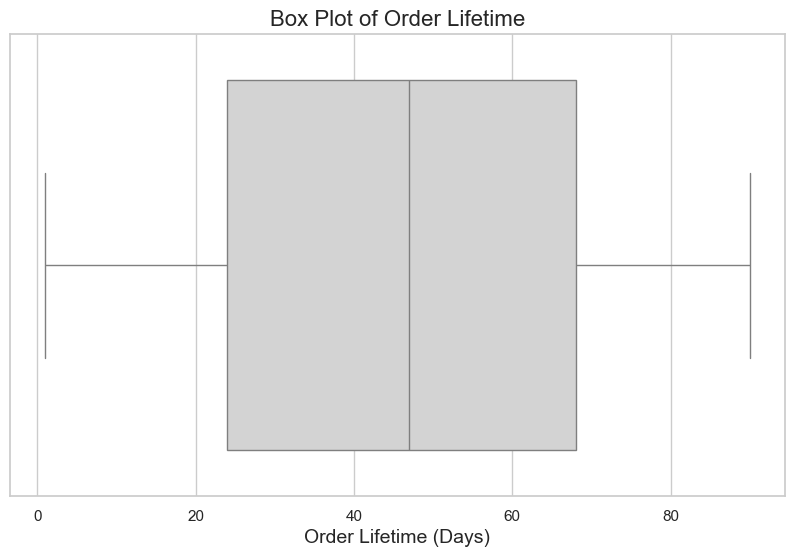

In [32]:
# Set the seaborn style to whitegrid
sns.set(style="whitegrid")

# Create a box plot for 'order_lifetime' where values are greater than 0
plt.figure(figsize=(10, 6))  # Adjust the size of the plot if necessary

# Use a box plot to visualize the distribution of 'order_lifetime'
sns.boxplot(x=df_filtered['order_lifetime'], color='lightgrey')

# Add x label and title
plt.title('Box Plot of Order Lifetime', fontsize=16)
plt.xlabel('Order Lifetime (Days)', fontsize=14)

# Show the plot
plt.show()

`Step 23` Creating 2 variables `D_orders` and `H_orders` that correspond to the cumulative sum of the orders by day of the week and by the hour of the day. 

In [34]:
# Creating a new column 'T_orders' that sums the orders from DOW_0 to DOW_6
df['D_orders'] = df[['DOW_0', 'DOW_1', 'DOW_2', 'DOW_3', 'DOW_4', 'DOW_5', 'DOW_6']].sum(axis=1)

# Creating a new column 'H_orders' that sums the orders from HR_0 to HR_23
df['H_orders'] = df[['HR_0', 'HR_1', 'HR_2', 'HR_3', 'HR_4', 'HR_5', 'HR_6', 'HR_7', 'HR_8', 'HR_9', 'HR_10', 'HR_11', 'HR_12', 
                    'HR_13', 'HR_14', 'HR_15', 'HR_16', 'HR_17', 'HR_18', 'HR_19', 'HR_20', 'HR_21', 'HR_22', 'HR_23']].sum(axis=1)

`Step 23.1` Checking if there are differences in the values in columns `D_orders` and `H_orders`.

In [36]:
are_equal = (df['D_orders'] == df['H_orders']).all()

if are_equal:
    print("All values in 'D_orders' and 'H_orders' are equal.")
else:
    print("There are differences between 'D_orders' and 'H_orders'.")

There are differences between 'T_orders' and 'H_orders'.


`Step 23.2` Checking if the difference in values in between the columns correspond to the mising values in column `HR_0`.

In [37]:
# First, create a mask for the differing rows between T_orders and H_orders
differing_rows_mask = (df['D_orders'] != df['H_orders'])

# Now, check if the HR_0 column has missing values in these differing rows
missing_hr0_in_differing_rows = df.loc[differing_rows_mask, 'HR_0'].isnull()

# Counting the number of rows where T_orders and H_orders differ and HR_0 is missing
missing_count = missing_hr0_in_differing_rows.sum()

# Displaying the results
if missing_count == missing_hr0_in_differing_rows.shape[0]:
    print("All rows where 'H_orders' differs from 'D_orders' correspond to missing values in 'HR_0'.")
else:
    print("Not all rows where 'H_orders' differs correspond to missing values in 'HR_0'.")

All rows where 'H_orders' differs from 'D_orders' correspond to missing values in 'HR_0'.


`Step 23.3` Checking the histograms of variables `D_orders` and `H_orders`.

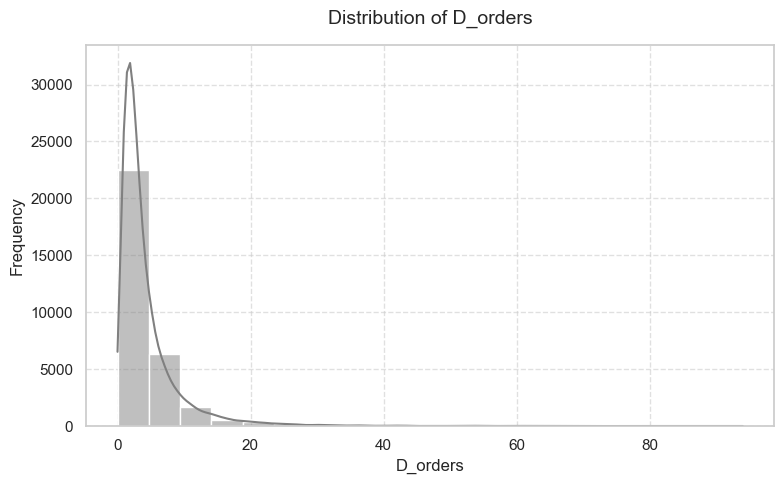

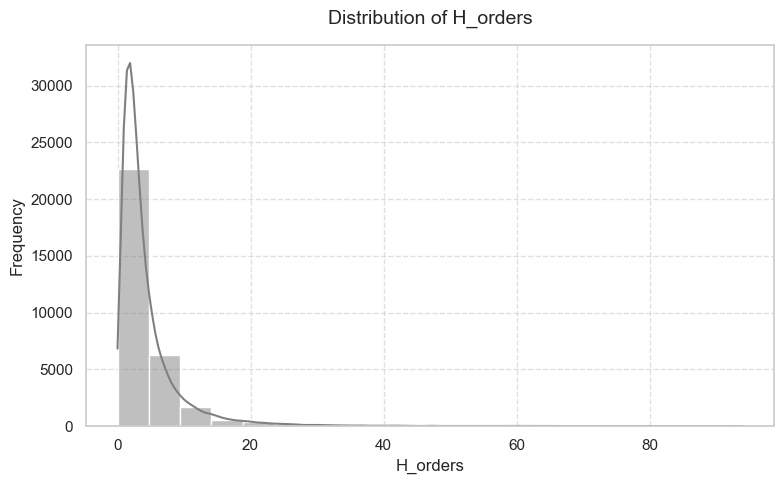

In [38]:
sns.set(style="whitegrid")

# Loop through each numeric feature
for val in ['D_orders','H_orders']:
    plt.figure(figsize=(8, 5))  # Set figure size for each plot
    sns.histplot(df[val], bins=20, kde=True, color='gray')  # Use seaborn for a better look, add KDE for smooth curve
    plt.title(f"Distribution of {val}", fontsize=14, pad=15)  # Adjust title font size and padding
    plt.xlabel(val, fontsize=12)  # Set x-axis label
    plt.ylabel('Frequency', fontsize=12)  # Set y-axis label
    plt.grid(True, linestyle='--', alpha=0.6)  # Add grid lines with light transparency
    plt.tight_layout()  # Ensure no overlap
    plt.show()  # Display the plot

`Step 23.4` Checking the box_Plot of `D_orders` and `H_orders`.

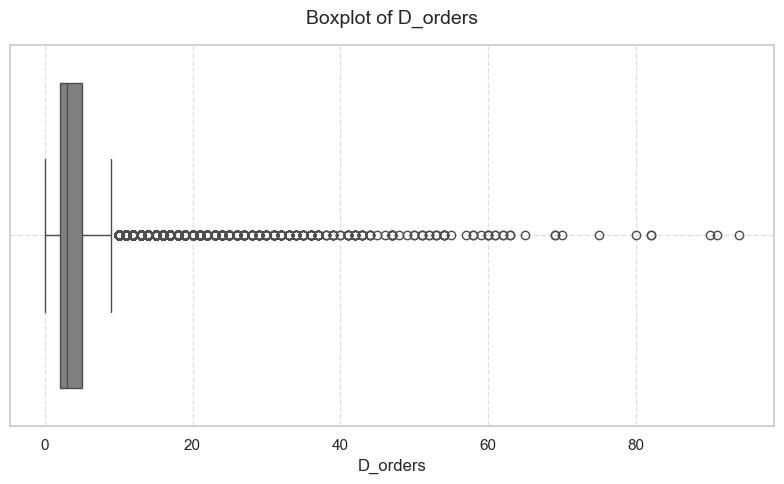

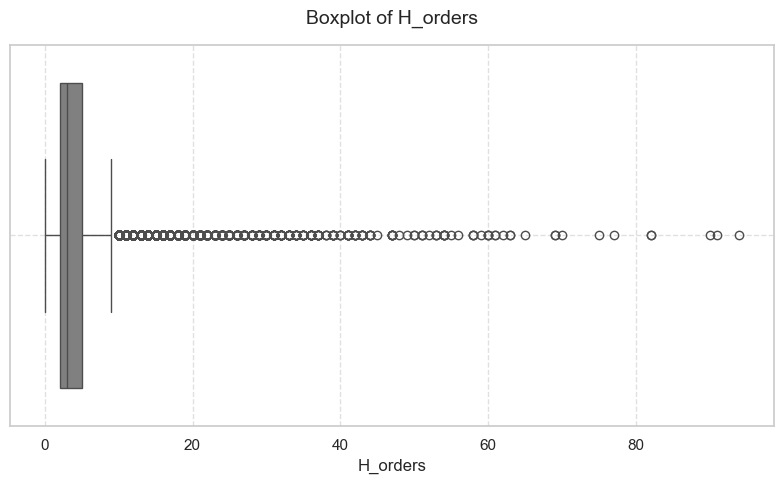

In [39]:
sns.set(style="whitegrid")

# Loop through each numeric feature to create boxplots
for val in ['D_orders','H_orders']:
    plt.figure(figsize=(8, 5))  # Set figure size for each plot
    sns.boxplot(x=df[val], color='gray')  # Create boxplot with specified color
    plt.title(f"Boxplot of {val}", fontsize=14, pad=15)  # Adjust title font size and padding
    plt.xlabel(val, fontsize=12)  # Set x-axis label
    plt.grid(True, linestyle='--', alpha=0.6)  # Add grid lines with light transparency
    plt.tight_layout()  # Ensure no overlap
    plt.show()

### Conclusions

`order_lifetime`

- We have a total of **7187 customers** that only ordered once in the company.
- This variable has a right tail distribution that is less skewed than the `first_order`.
- By not considering the customers that only made a purchase in the company, the order_lifetime follows a distribution that is more approximate to an uniform distribution, only registering a significant drop if the value is above 80.
- The boxplot of this variable resembles a more or symetric distribution and does not present outliers.

`D_orders` and `H_orders`

- The values in `D_orders` and `H_orders` are not equal, despite the fact they should be.
- This difference is due to the missing values obversed on variable `HR_0`.
- The distribution of these variables as expected conserve the same right skeweness as all the variables `DOW_` and `HR_`.
- This variable also conserve the outliers and seem to have more outliers than the individual features.

### 3.7. Multivariate Analysis

#### Pairwise relationship of Numerical features

`Step 24` Computing the spearman correlation matrix for the original dataset numeric features.

In [29]:
cor_spearman = df[numeric_features].corr(method = 'spearman')
cor_spearman

,customer_age,vendor_count,product_count,first_order,last_order,CUI_American,CUI_Asian,CUI_Beverages,CUI_Cafe,CUI_Chicken Dishes,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_age,1.000000,0.004398,0.010459,0.000132,0.013010,0.003962,0.005853,-0.004451,0.002682,-0.002442,...,0.001308,0.007903,-0.004856,0.006110,0.009173,0.000302,0.001777,0.007604,-0.007065,0.003834
vendor_count,0.004398,1.000000,0.845140,-0.464773,0.458544,0.354940,0.301094,0.253408,0.174643,0.249545,...,0.256785,0.221579,0.236674,0.268615,0.283642,0.279419,0.236035,0.179230,0.146681,0.146223
product_count,0.010459,0.845140,1.000000,-0.485419,0.485540,0.313364,0.283923,0.196104,0.169827,0.203202,...,0.290717,0.280218,0.295122,0.309499,0.300035,0.273206,0.217299,0.169628,0.138007,0.141877
first_order,0.000132,-0.464773,-0.485419,1.000000,0.091424,-0.208712,-0.108993,-0.126836,-0.089065,-0.144452,...,-0.162445,-0.150636,-0.175964,-0.193910,-0.196025,-0.181037,-0.148601,-0.112837,-0.078396,-0.075821
last_order,0.013010,0.458544,0.485540,0.091424,1.000000,0.176870,0.163791,0.090127,0.106346,0.094670,...,0.164400,0.200464,0.191500,0.179684,0.150508,0.124986,0.097940,0.089123,0.081049,0.070287
CUI_American,0.003962,0.354940,0.313364,-0.208712,0.176870,1.000000,0.009463,-0.013955,0.065735,0.000508,...,0.116680,0.135604,0.149207,0.130719,0.108244,0.075503,0.071665,0.057212,0.054072,0.062026
CUI_Asian,0.005853,0.301094,0.283923,-0.108993,0.163791,0.009463,1.000000,0.035434,-0.012016,-0.102139,...,0.019059,-0.005954,-0.028110,-0.058481,-0.074560,-0.077823,-0.071539,-0.053536,0.009440,0.060277
CUI_Beverages,-0.004451,0.253408,0.196104,-0.126836,0.090127,-0.013955,0.035434,1.000000,-0.042118,0.094851,...,0.068779,-0.006360,-0.062407,-0.039032,0.015398,0.075463,0.097346,0.079700,0.056331,0.061750
CUI_Cafe,0.002682,0.174643,0.169827,-0.089065,0.106346,0.065735,-0.012016,-0.042118,1.000000,-0.008781,...,0.094684,0.108122,0.137357,0.125825,0.094102,0.060248,0.037929,0.019904,0.002235,-0.005089
CUI_Chicken Dishes,-0.002442,0.249545,0.203202,-0.144452,0.094670,0.000508,-0.102139,0.094851,-0.008781,1.000000,...,0.096850,0.058386,0.050193,0.125007,0.211132,0.251150,0.232842,0.162839,0.117441,0.067576


`Step 24.1` Remove `HR_0` from the correlation matrix since the correlations are all NaN

In [30]:
cor_spearman = cor_spearman.drop('HR_0', axis=0)  # Drop the row
cor_spearman = cor_spearman.drop('HR_0', axis=1)  # Drop the column

`Step 24.2` Define a function *cor_heatmap()* that takes the correlation matrix and displays a heat map of it.

In [44]:
def cor_heatmap(cor):
    plt.figure(figsize=(40,40))
    sns.heatmap(data = cor, annot = True, cmap = plt.cm.Purples, fmt='.1')
    plt.show()

`Step 24.3` Print the heat map of the correlation matrix.

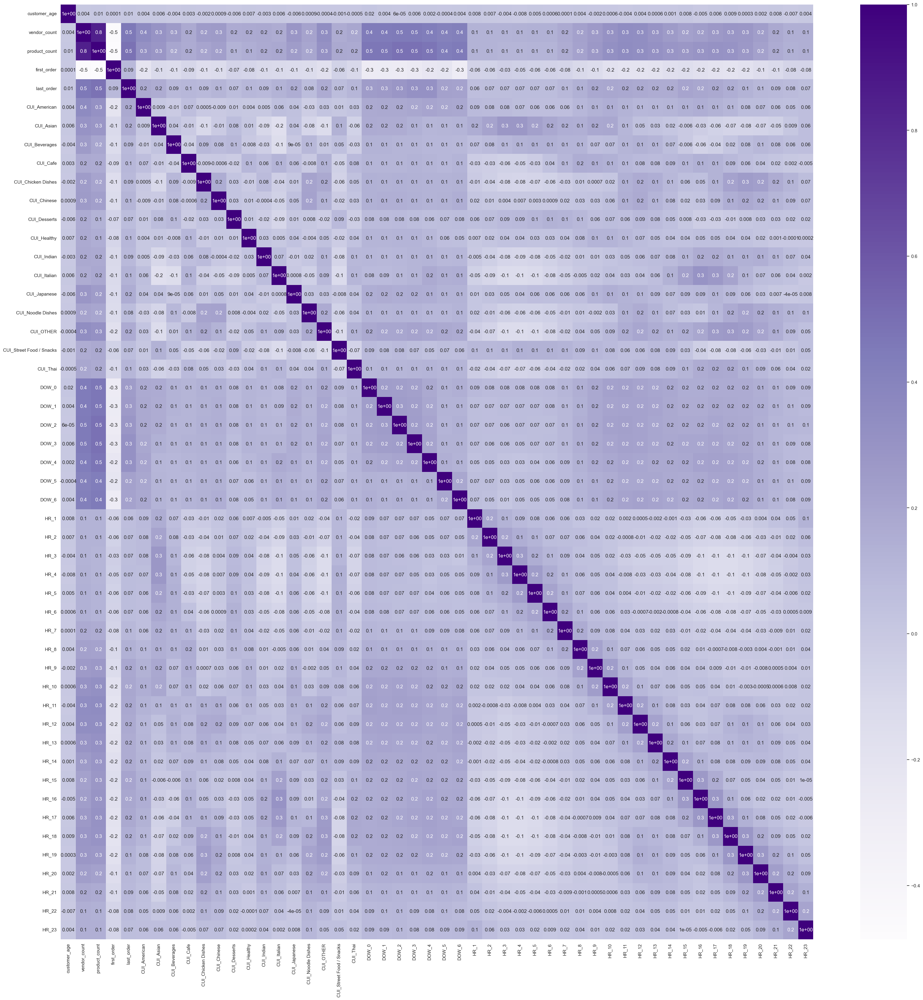

In [32]:
cor_heatmap(cor_spearman)

`Step 24.4` Create a new list *add_numeric_features* with the additional features and removing the variables regarding `DOW_` and `HR_` and compute the correlation matrix of the variables in the list. 

In [42]:
add_numeric_features = ["customer_age", "vendor_count", "product_count", "first_order", "last_order", "order_lifetime","D_orders"
                        ,"H_orders"] + cuisine_columns

add_cor_spearman = df[add_numeric_features].corr(method = 'spearman')
add_cor_spearman

,customer_age,vendor_count,product_count,first_order,last_order,order_lifetime,D_orders,H_orders,CUI_American,CUI_Asian,...,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai
customer_age,1.000000,0.004398,0.010459,0.000132,0.013010,0.009834,0.009520,0.009257,0.003962,0.005853,...,0.000868,-0.005900,0.006617,-0.002899,0.006242,-0.005826,0.000897,-0.000403,-0.000992,-0.000537
vendor_count,0.004398,1.000000,0.845140,-0.464773,0.458544,0.757287,0.888704,0.883880,0.354940,0.301094,...,0.254172,0.166238,0.172379,0.178311,0.161705,0.284421,0.207784,0.337274,0.163352,0.188629
product_count,0.010459,0.845140,1.000000,-0.485419,0.485540,0.785521,0.948307,0.942506,0.313364,0.283923,...,0.231221,0.126522,0.147734,0.171912,0.187121,0.247224,0.193888,0.310310,0.179799,0.171620
first_order,0.000132,-0.464773,-0.485419,1.000000,0.091424,-0.652906,-0.511351,-0.509209,-0.208712,-0.108993,...,-0.135095,-0.072932,-0.079887,-0.108013,-0.117995,-0.122276,-0.127058,-0.174661,-0.060022,-0.102378
last_order,0.013010,0.458544,0.485540,0.091424,1.000000,0.603135,0.510253,0.508749,0.176870,0.163791,...,0.113753,0.073054,0.102047,0.094798,0.128206,0.153573,0.075941,0.169492,0.071639,0.108104
order_lifetime,0.009834,0.757287,0.785521,-0.652906,0.603135,1.000000,0.833797,0.829952,0.298800,0.216050,...,0.186547,0.106460,0.136538,0.147917,0.186949,0.208748,0.153844,0.256808,0.102965,0.155707
D_orders,0.009520,0.888704,0.948307,-0.511351,0.510253,0.833797,1.000000,0.994661,0.342331,0.257361,...,0.233512,0.128936,0.167972,0.174001,0.216117,0.257865,0.191469,0.318794,0.124385,0.186242
H_orders,0.009257,0.883880,0.942506,-0.509209,0.508749,0.829952,0.994661,1.000000,0.338498,0.250059,...,0.233151,0.129033,0.169621,0.174621,0.219054,0.259925,0.189475,0.320958,0.121000,0.187947
CUI_American,0.003962,0.354940,0.313364,-0.208712,0.176870,0.298800,0.342331,0.338498,1.000000,0.009463,...,-0.009404,0.011088,0.004305,0.005016,0.059047,0.044716,-0.028205,0.027826,0.013551,0.030503
CUI_Asian,0.005853,0.301094,0.283923,-0.108993,0.163791,0.216050,0.257361,0.250059,0.009463,1.000000,...,-0.014343,0.075729,0.010865,-0.094723,-0.165666,0.041862,-0.081342,-0.129604,0.131373,-0.059093


`Step 24.5` Print the heat map of the correlation matrix *add_cor_spearman*.

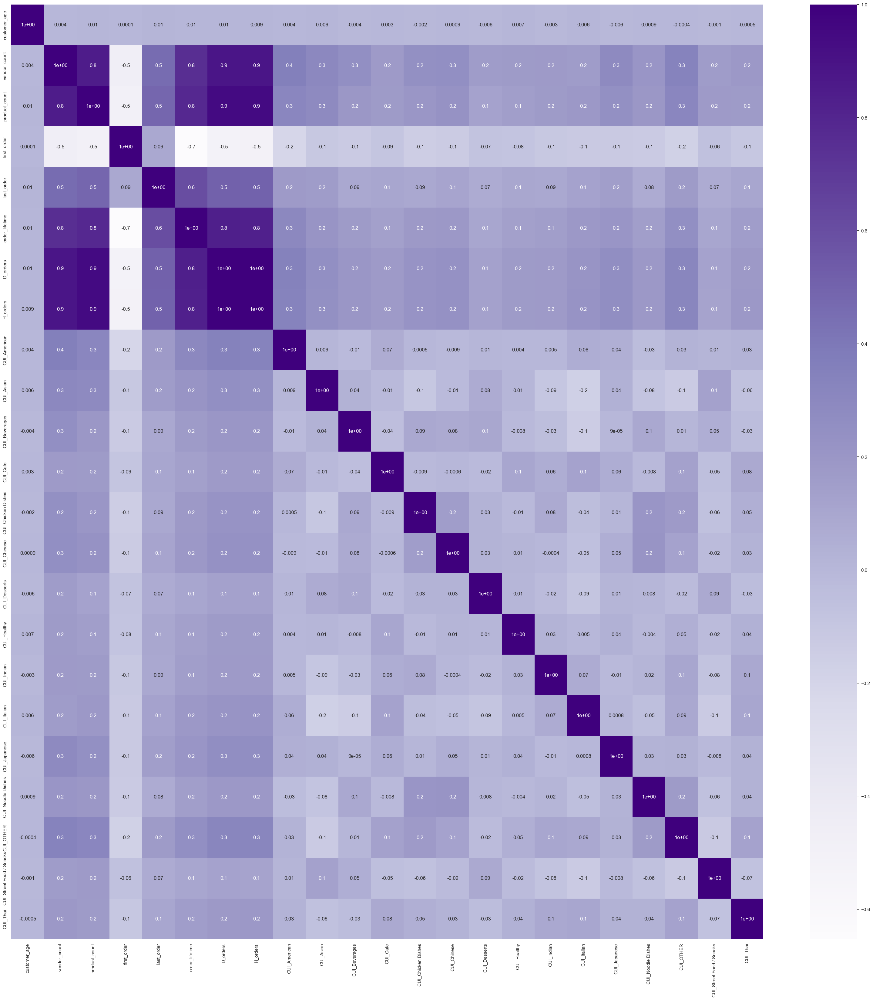

In [45]:
cor_heatmap(add_cor_spearman)

`Step 24.6` Ploting the Correlation matrix only displaying the values of correlation above 0.5.

In [65]:
def cor_heatmap1(cor, threshold=0.5):
    # Create a mask that displays only correlations above the threshold
    annot = np.where((cor >= threshold) | (cor <= -threshold), cor.round(2), "")  # Round numeric values
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(data=cor, annot=annot, cmap='Purples', center=0, linewidths=0.5, linecolor='black',
                cbar_kws={'shrink': 0.75}, annot_kws={"size": 10}, fmt='')  # Empty format for mixed strings and floats
    plt.xticks(rotation=45, ha='right')  # Rotating x-axis labels for clarity
    plt.yticks(rotation=0)  # Ensuring y-axis labels are horizontal
    plt.show()

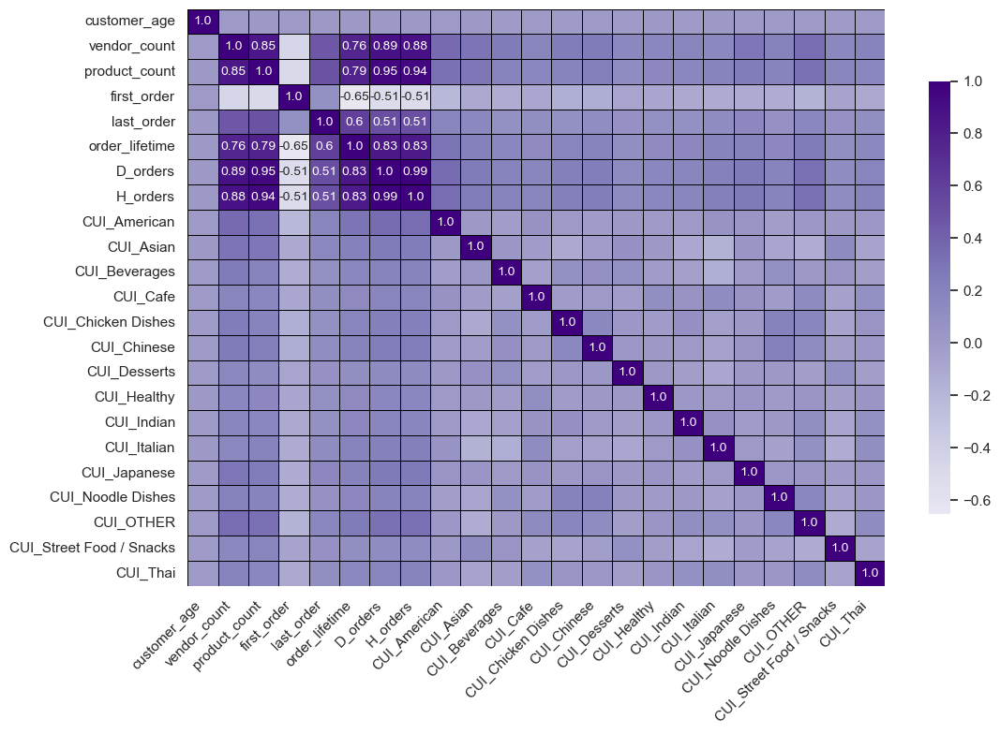

In [66]:
cor_heatmap1(add_cor_spearman)

`Step 25` Compute the pairwise scatterplots of all numerical features in the dataset.

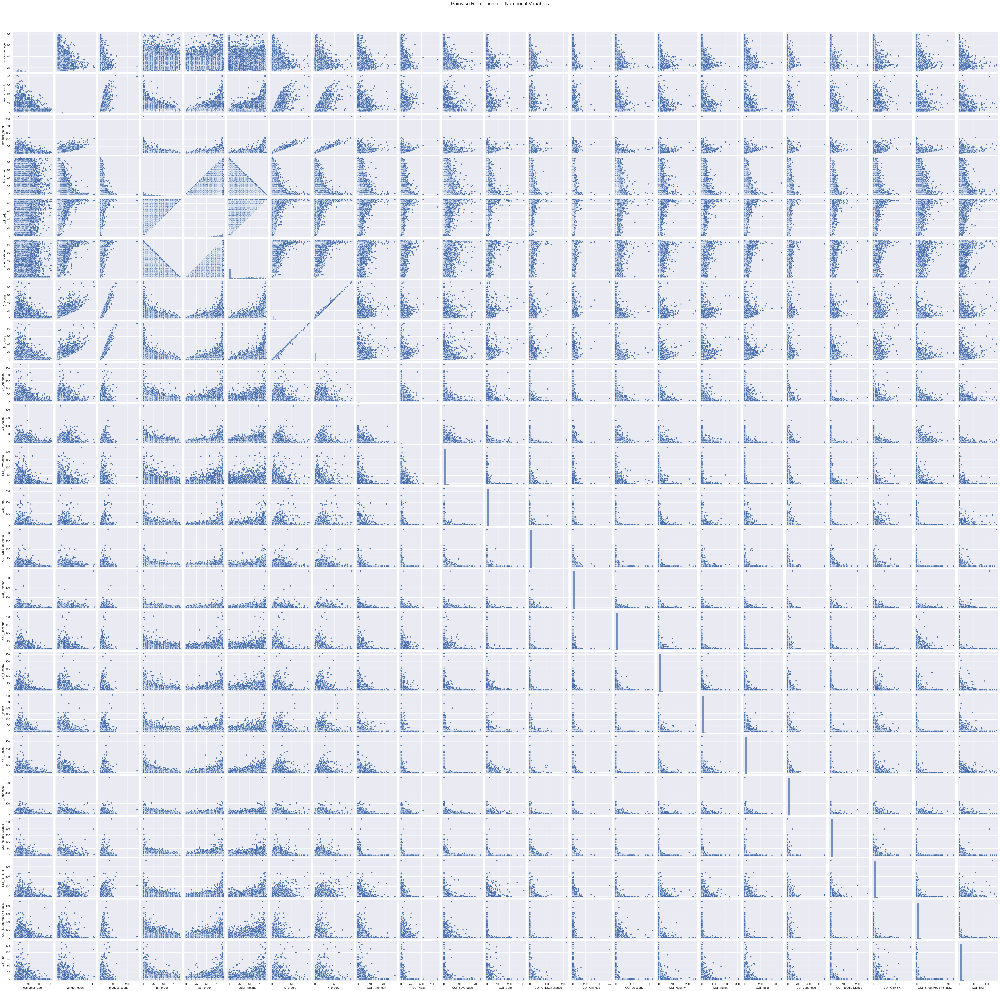

In [69]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df[add_numeric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

# if the eda directory is not present then create it first
if not os.path.exists(os.path.join('..', 'figures', 'eda')):
    os.makedirs(os.path.join('..', 'figures', 'eda'))
    
plt.savefig(os.path.join('..', 'figures', 'eda', 'pairwise_numeric_scatterplots.png'), dpi=200)
plt.show()

#### Comparing categorical features

`Step 26` Plot the `is_chain`, `payment method` and `customer_region` against `last_promo`.

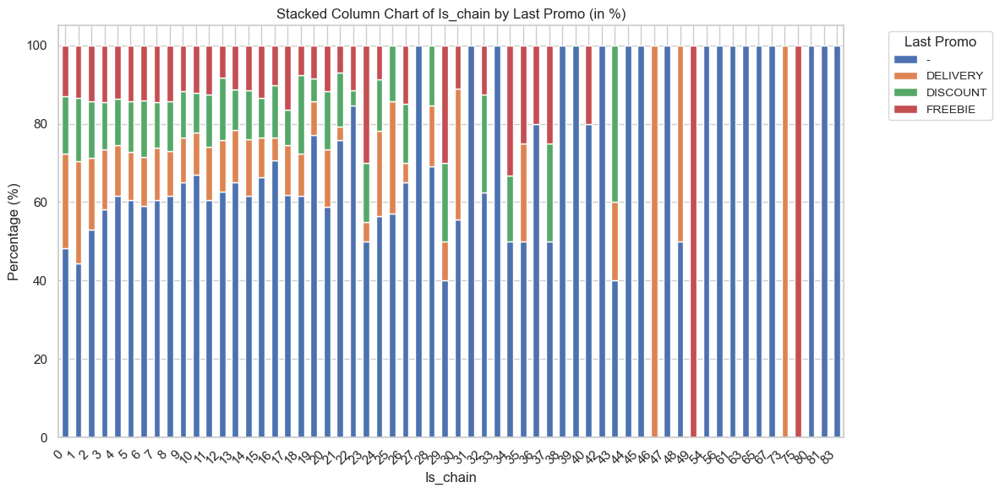

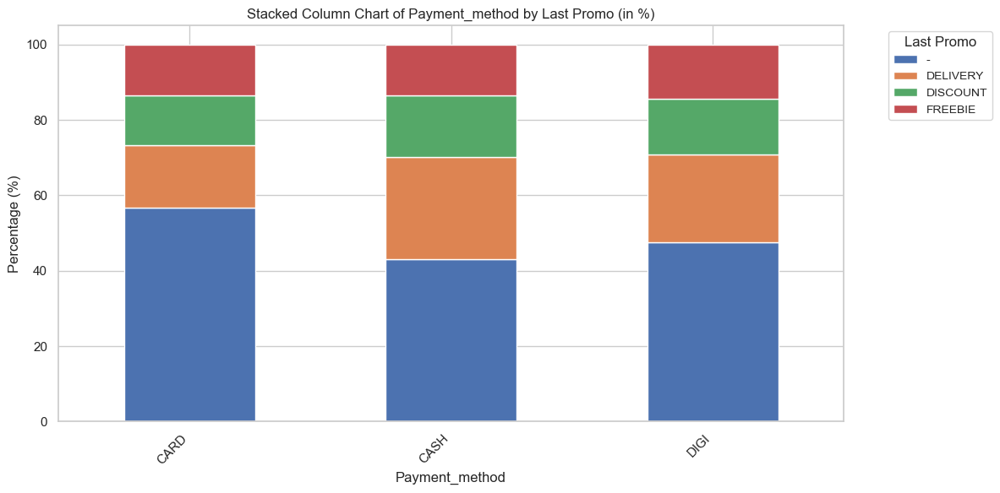

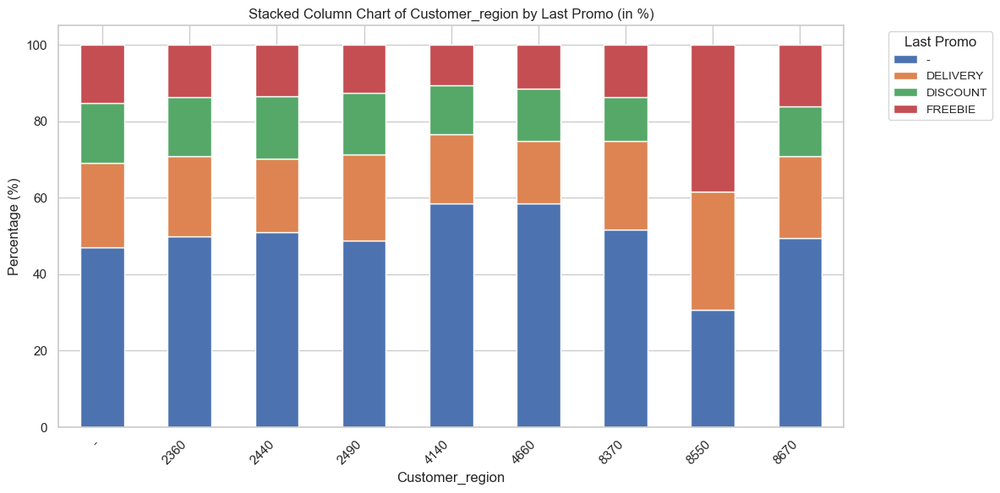

In [107]:
# Loop through the categorical features (excluding 'last_promo')
for feature in categorical_features:
    if feature != "last_promo":
        # Create a crosstab of 'is_chain' and 'last_promo' instead
        ct = pd.crosstab(df[feature], df['last_promo'])
        
        # Normalize the counts to percentages
        ct_percentage = ct.div(ct.sum(axis=1), axis=0) * 100
        
        # Plotting the stacked column chart
        ct_percentage.plot(kind='bar', stacked=True, figsize=(12, 6))

        # Adding labels and title
        plt.xlabel(f'{feature.capitalize()}')  # is_chain on the x-axis
        plt.ylabel('Percentage (%)')
        plt.title(f'Stacked Column Chart of {feature.capitalize()} by Last Promo (in %)')
        plt.xticks(rotation=45, ha='right')
        plt.legend(title='Last Promo', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small', title_fontsize='medium')
        plt.tight_layout()  # Adjust layout
        plt.show()

`Step 27` Plot `is_chain` and `customer_region` against `payment_method`.

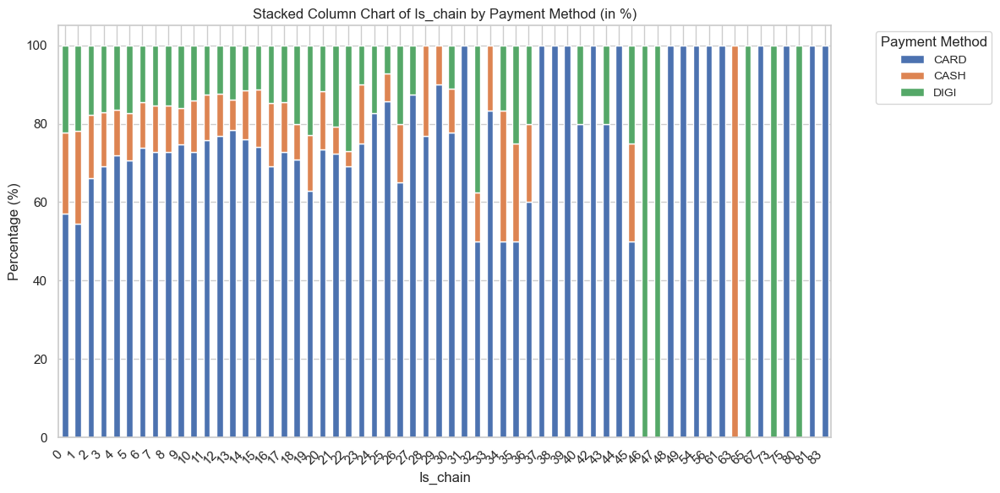

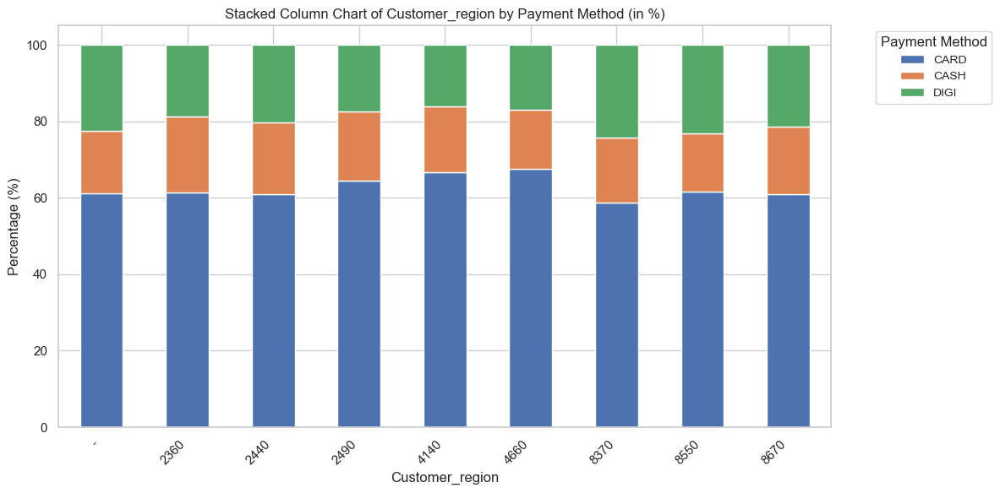

In [110]:
# Loop through the categorical features (excluding 'last_promo' and 'payment_method')
for feature in categorical_features:
    if feature not in ["last_promo", "payment_method"]:  # Exclude 'last_promo' and 'payment_method'
        # Create a crosstab of the feature and 'payment_method'
        ct = pd.crosstab(df[feature], df['payment_method'])
        
        # Normalize the counts to percentages
        ct_percentage = ct.div(ct.sum(axis=1), axis=0) * 100
        
        # Plotting the stacked column chart
        ct_percentage.plot(kind='bar', stacked=True, figsize=(12, 6))

        # Adding labels and title
        plt.xlabel(f'{feature.capitalize()}')  # Feature on the x-axis
        plt.ylabel('Percentage (%)')
        plt.title(f'Stacked Column Chart of {feature.capitalize()} by Payment Method (in %)')
        plt.xticks(rotation=45, ha='right')
        plt.legend(title='Payment Method', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small', title_fontsize='medium')
        plt.tight_layout()  # Adjust layout
        plt.show()

`Step 28` Plot `is_chain` against `customer_region`.

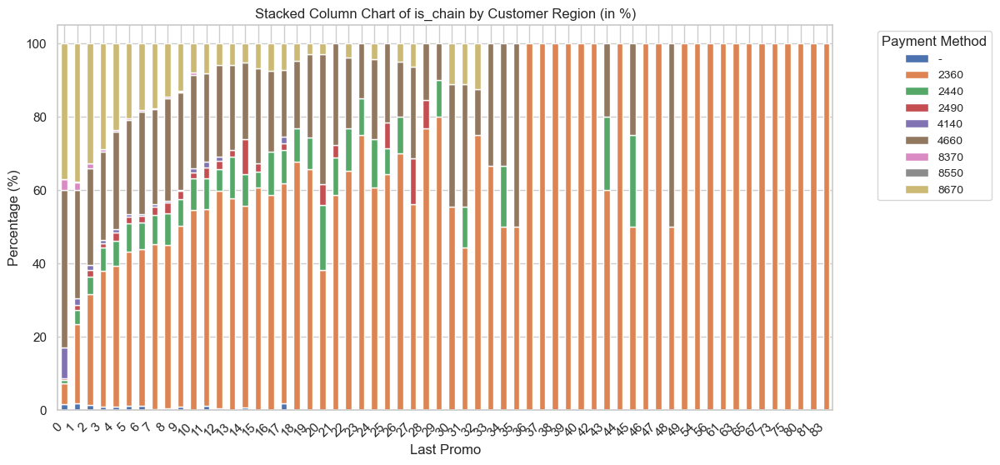

In [109]:
# Create a crosstab of the two variables
ct = pd.crosstab(df['is_chain'], df['customer_region'])

# Normalize the counts to percentages
ct_percentage = ct.div(ct.sum(axis=1), axis=0) * 100

# Plotting the stacked column chart
ct_percentage.plot(kind='bar', stacked=True, figsize=(12, 6))

# Adding labels and title
plt.xlabel('Last Promo')
plt.ylabel('Percentage (%)')
plt.title('Stacked Column Chart of is_chain by Customer Region (in %)')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Payment Method', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize='small', title_fontsize='medium')
plt.show()

#### Comparing categorical variables vs continuous (or discrete) variables

`Step 29` Ploting the histogram of numeric feature not related to the type of cuisine, hour of the order or day of the order against `last_promotion`.

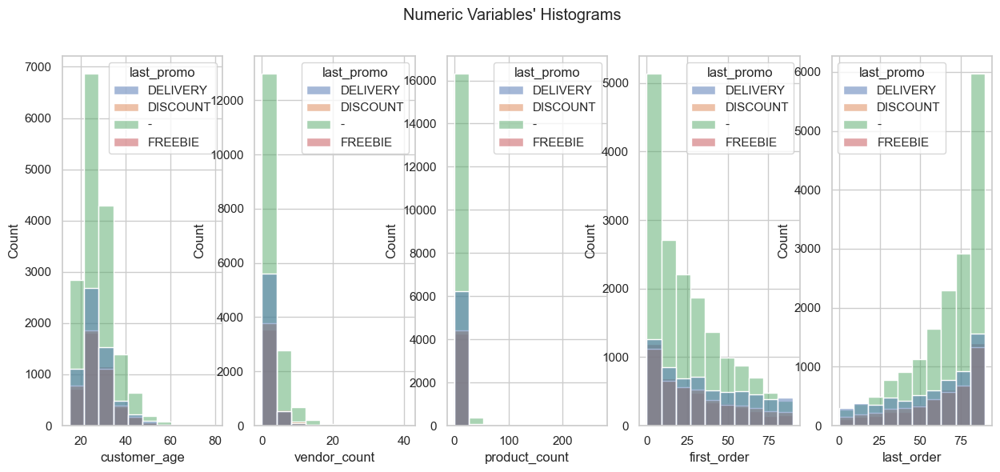

In [114]:
# Create a list called numeric_pt1, for only printing a fraction of the numeric features (for better visual appeal of the visualizations)
numeric_pt1 = ["customer_age", "vendor_count", "product_count", "first_order", "last_order"]

sp_rows = 1
sp_cols = 5


# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(15, 6))

# Plot data
for ax, feat in zip(axes.flatten(), numeric_pt1): 
    sns.histplot(df, x=feat, ax=ax, bins=10, hue='last_promo')
    
# Layout
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.show()

`Step 29.1` Ploting the histogram of numeric feature not related to the type of cuisine, hour of the order or day of the order against `payment_method`.

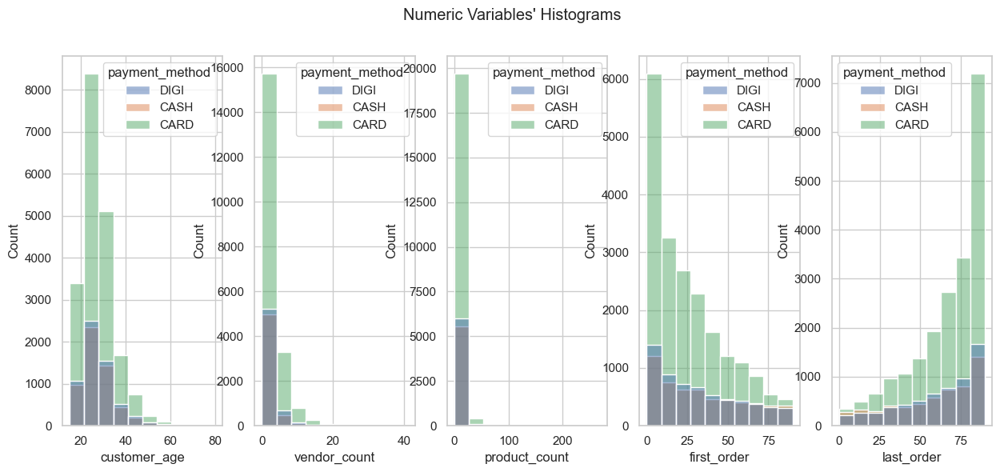

In [133]:
# Create a list called numeric_pt1, for only printing a fraction of the numeric features (for better visual appeal of the visualizations)
sp_rows = 1
sp_cols = 5

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(15, 6))

# Plot data
for ax, feat in zip(axes.flatten(), numeric_pt1): 
    sns.histplot(df, x=feat, ax=ax, bins=10, hue='payment_method')
    
# Layout
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.show()

`Step 29.2` Ploting the histogram of numeric feature not related to the type of cuisine, hour of the order or day of the order against `customer_region`.

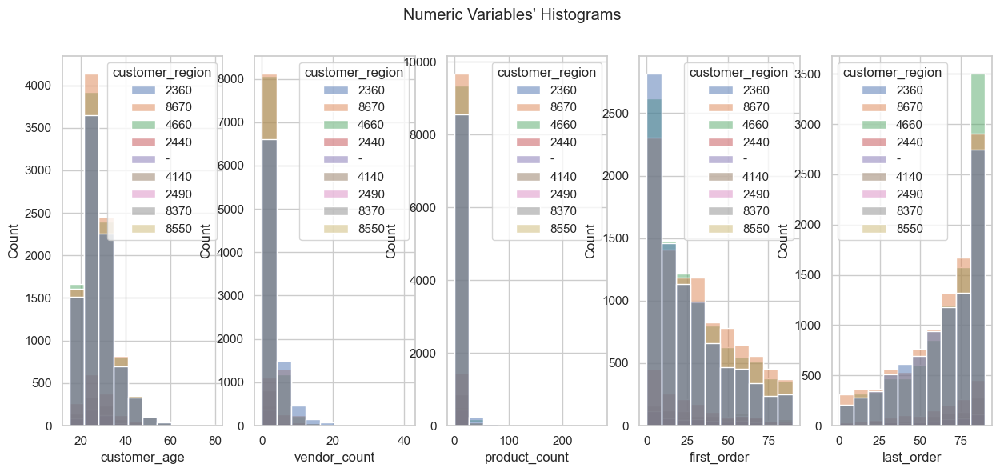

In [116]:
sp_rows = 1
sp_cols = 5


# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(sp_rows, 
                         sp_cols, 
                         figsize=(15, 6))

# Plot data
for ax, feat in zip(axes.flatten(), numeric_pt1): 
    sns.histplot(df, x=feat, ax=ax, bins=10, hue='customer_region')
    
# Layout
title = "Numeric Variables' Histograms"

plt.suptitle(title)

plt.show()

`Step 29.3` Creating scatterplots of all numeric_features against variable `last_promo`.

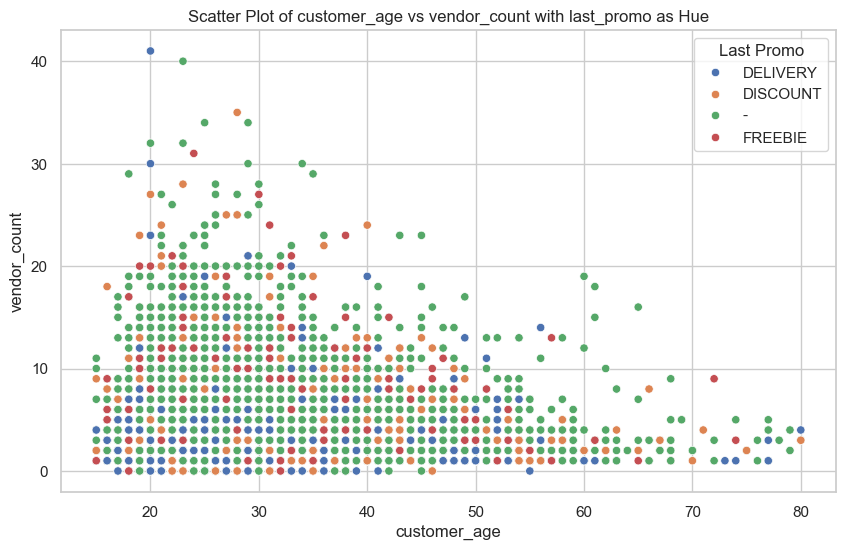

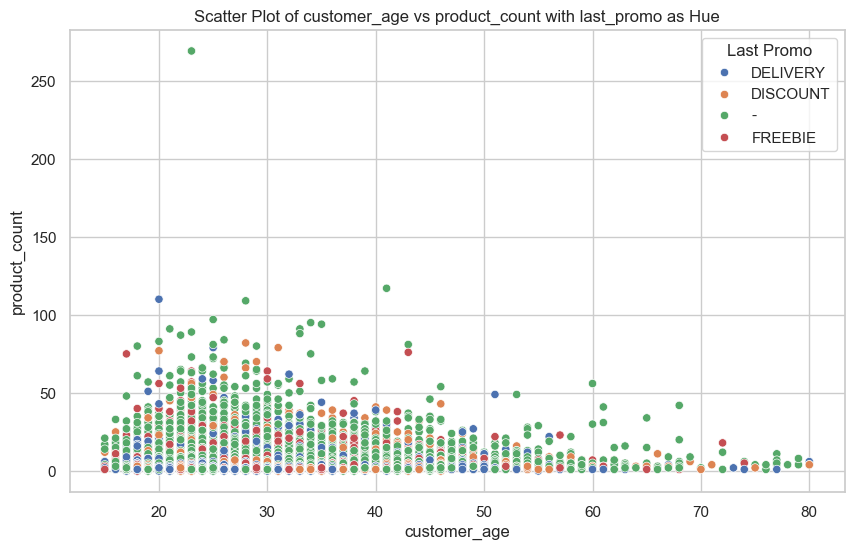

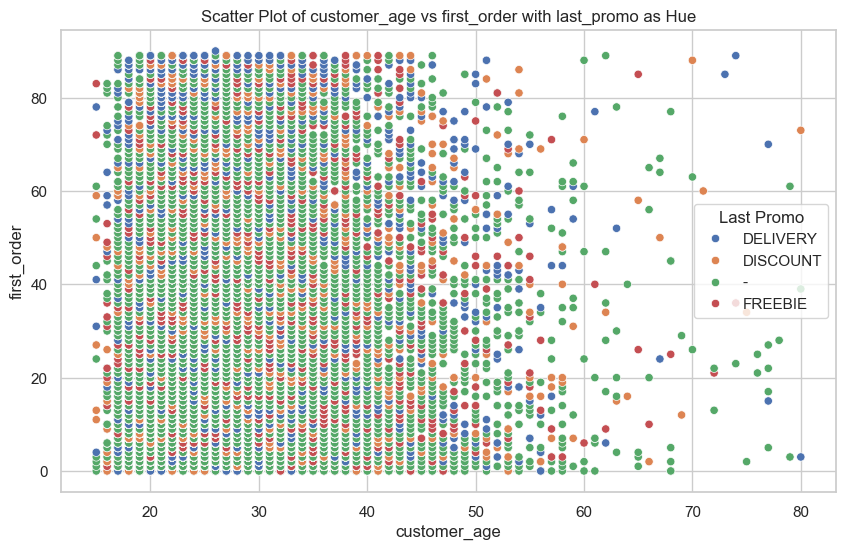

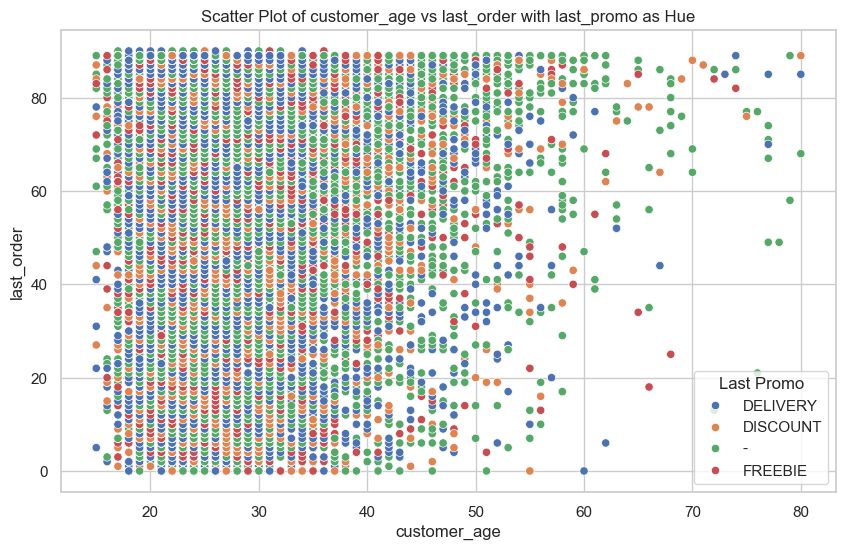

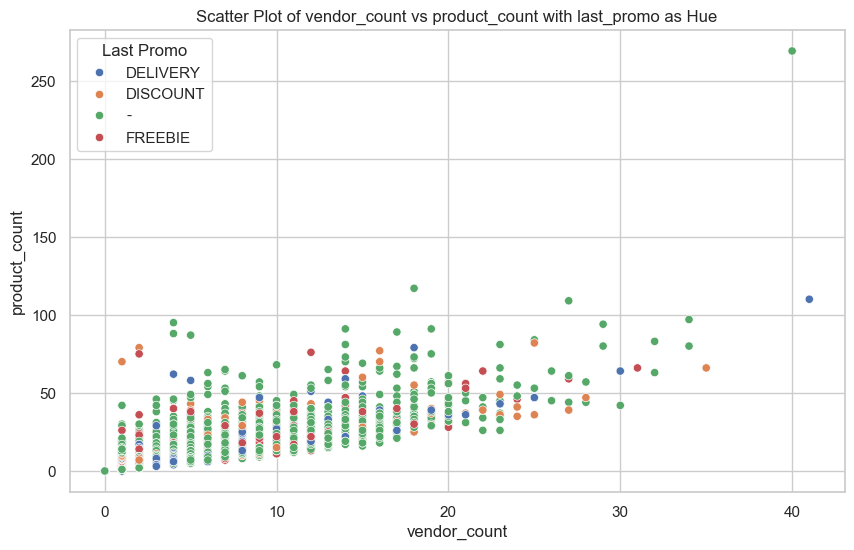

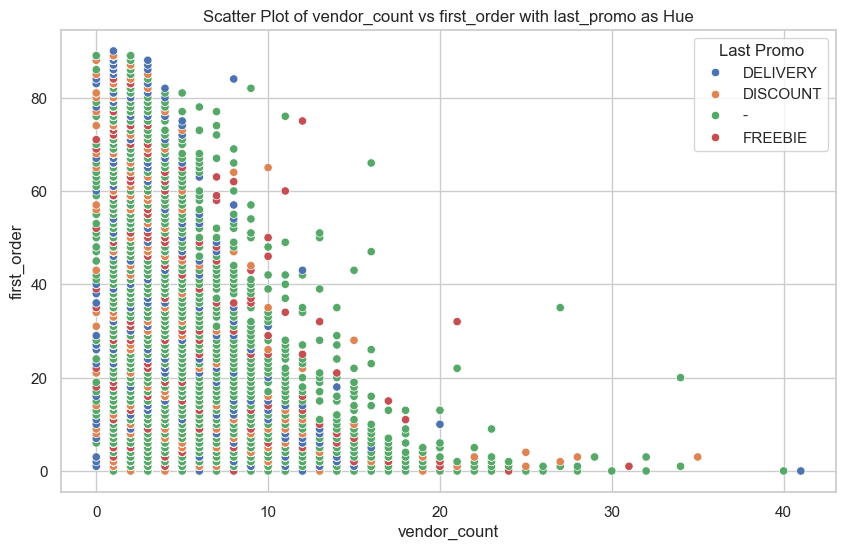

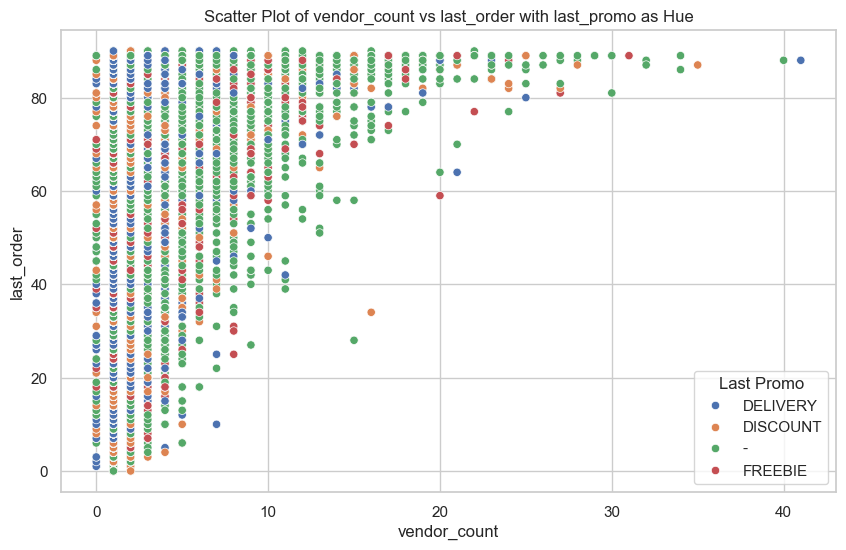

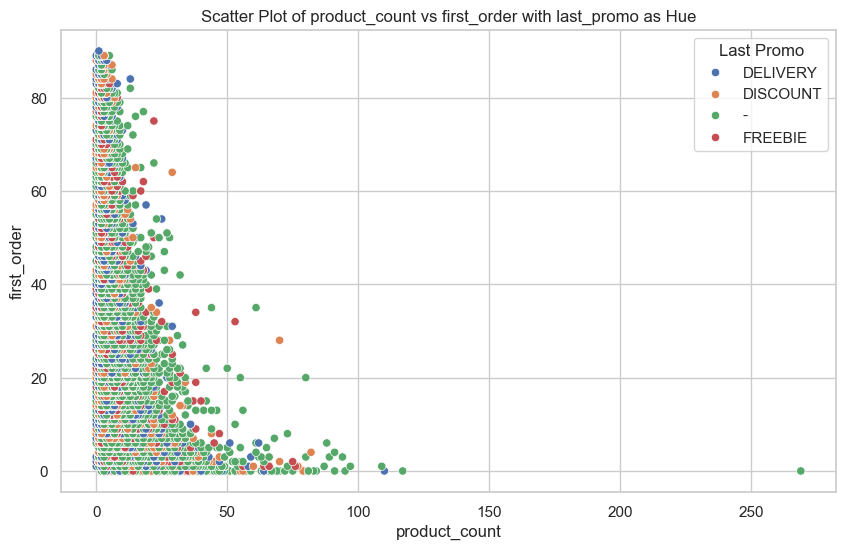

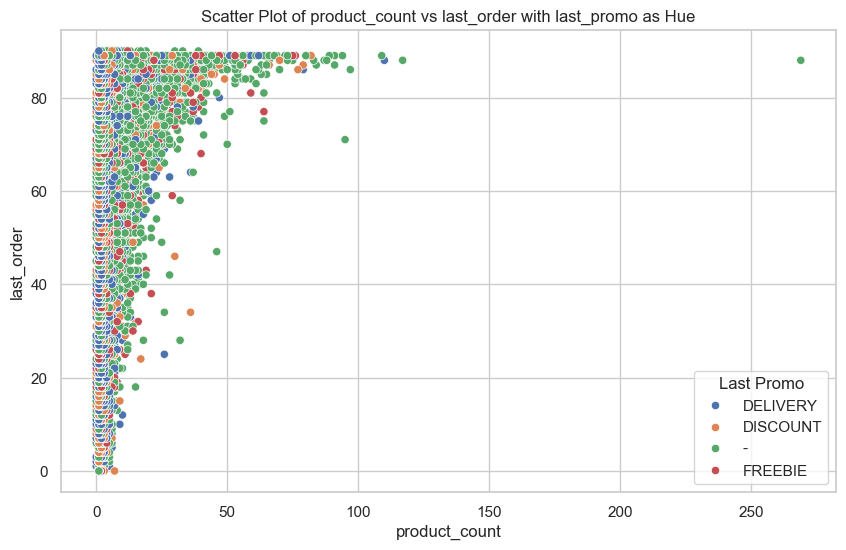

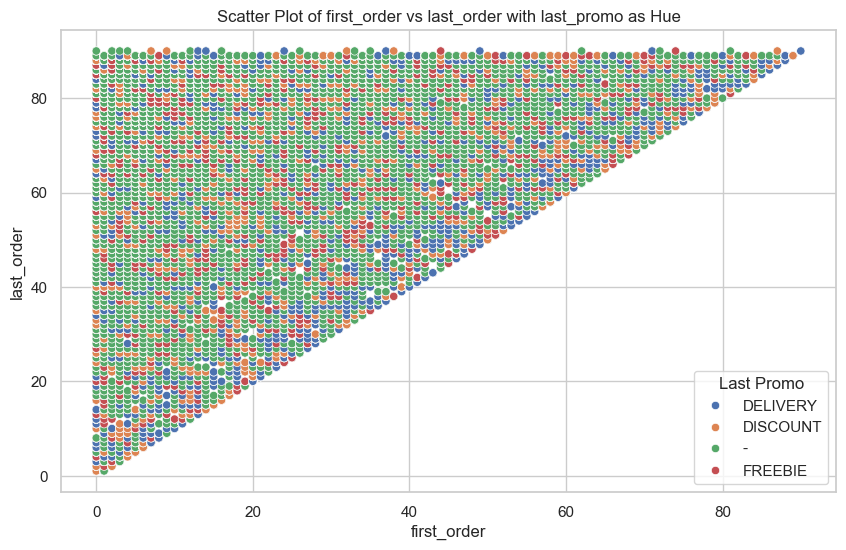

In [138]:
for i in range(len(numeric_pt1)):
    for j in range(i + 1, len(numeric_pt1)):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(data=df, x=numeric_pt1[i], y=numeric_pt1[j], hue='last_promo', palette='deep')

        # Adding titles and labels
        plt.title(f'Scatter Plot of {numeric_pt1[i]} vs {numeric_pt1[j]} with last_promo as Hue')
        plt.xlabel(numeric_pt1[i])
        plt.ylabel(numeric_pt1[j])
        plt.legend(title='Last Promo')
        
        # Show the plot
        plt.show()

`Step 29.4` Creating scatterplots of all numeric_features against variable `payment_method`.

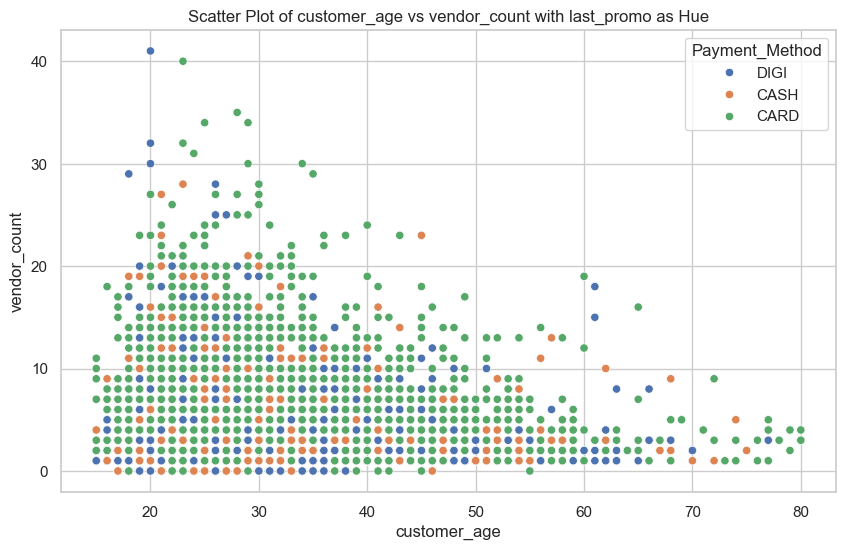

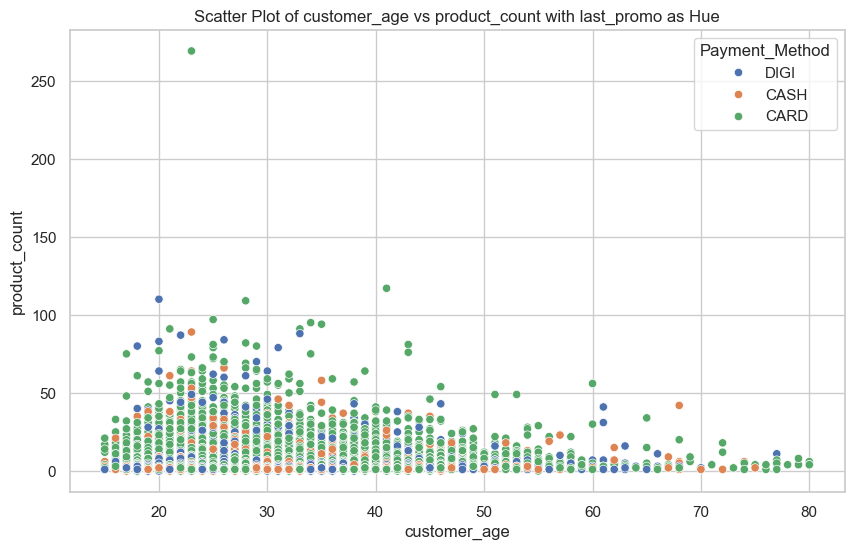

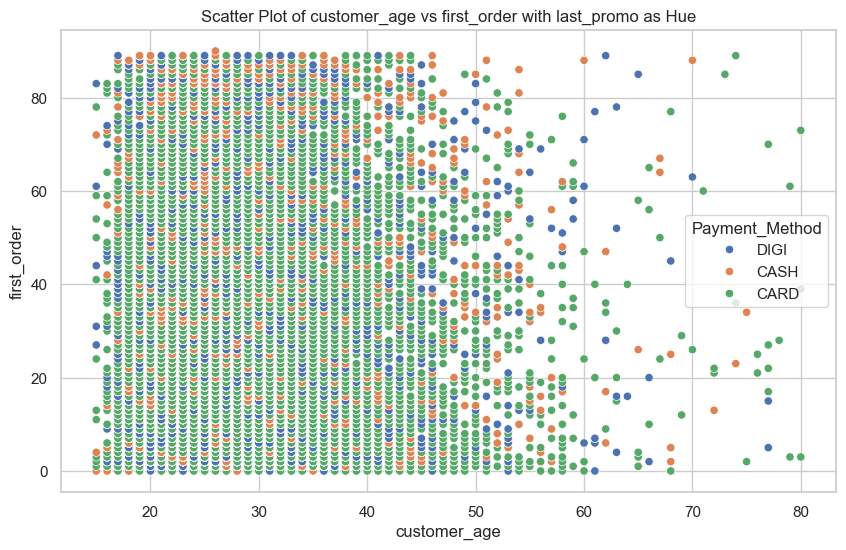

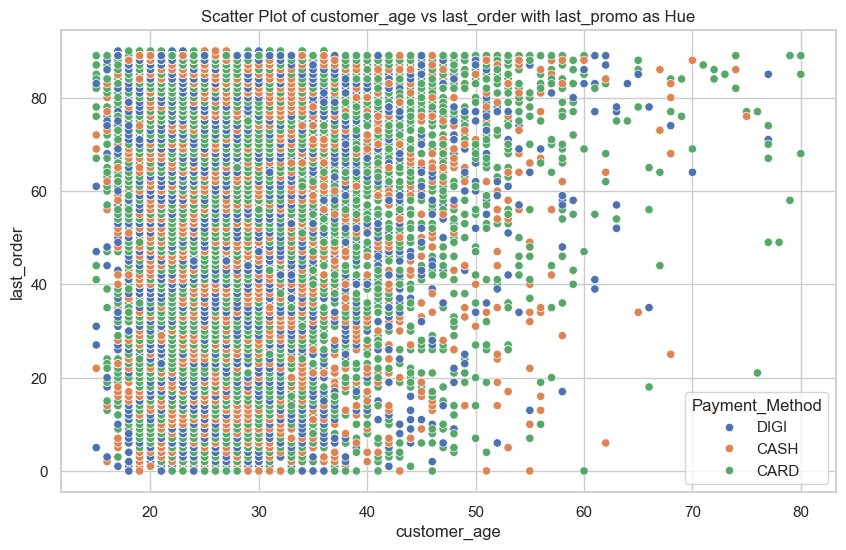

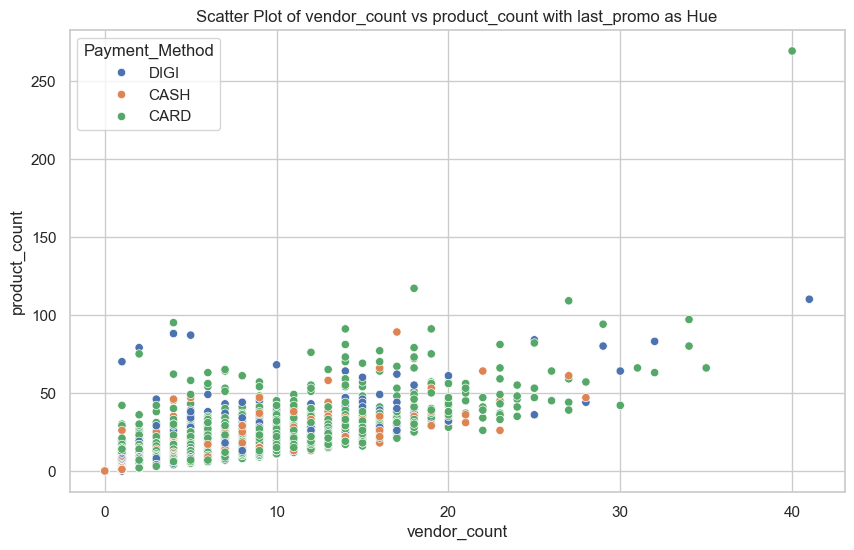

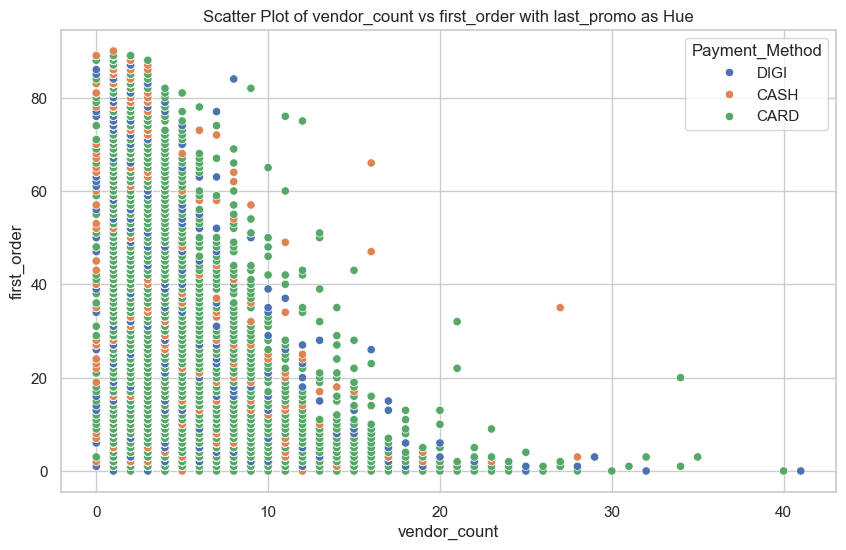

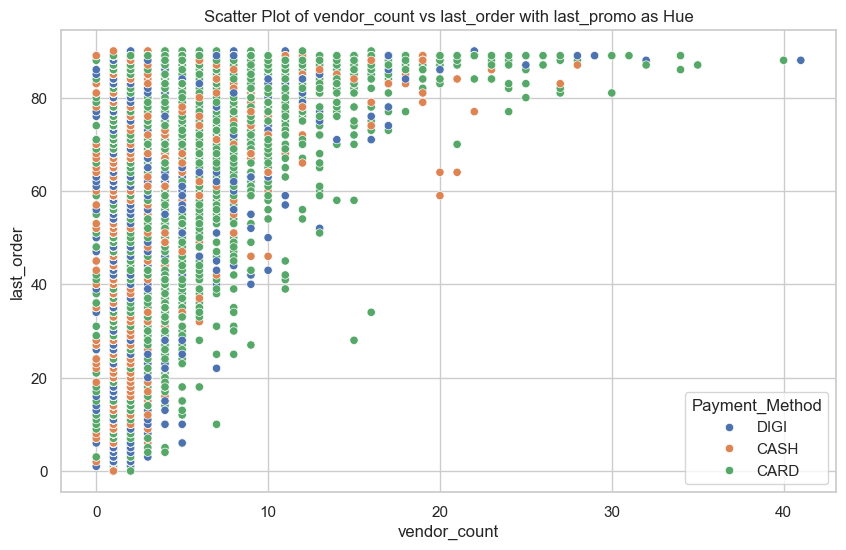

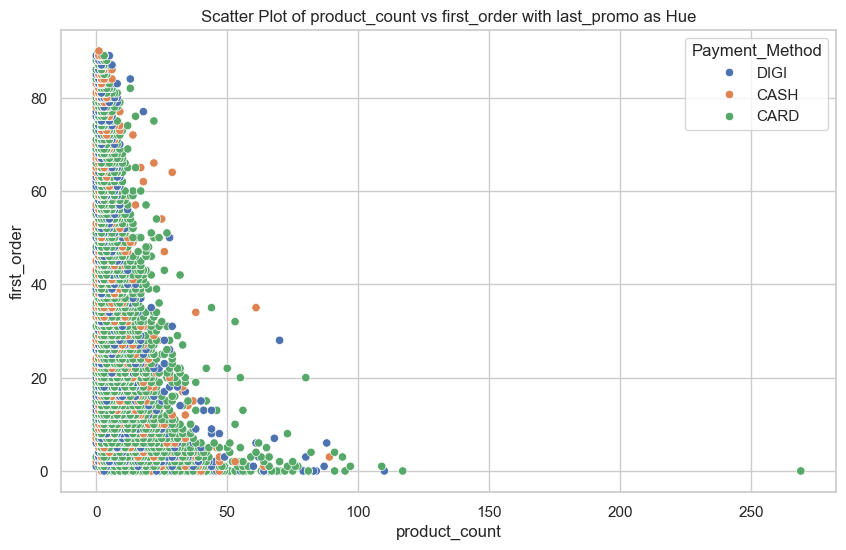

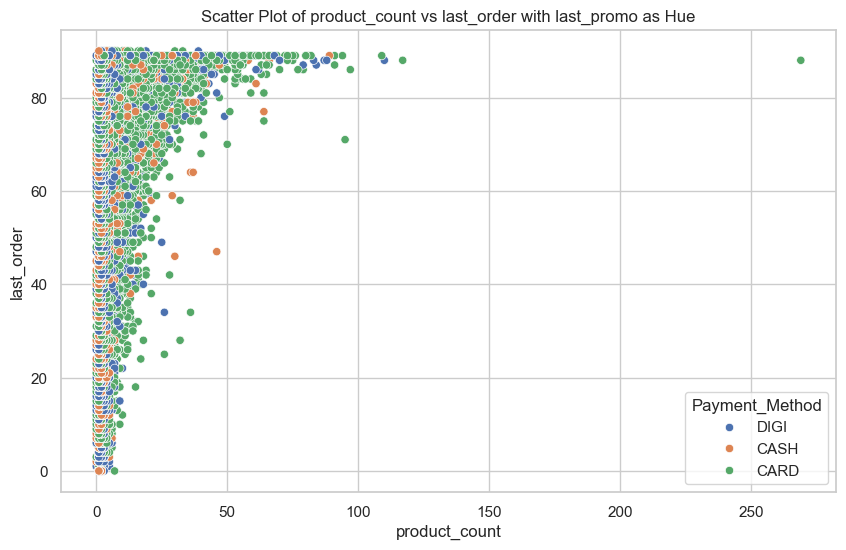

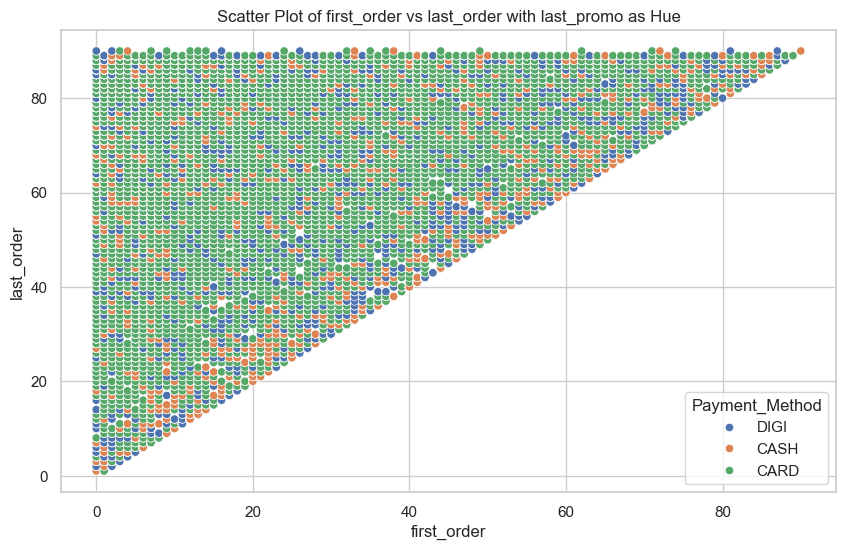

In [148]:
for i in range(len(numeric_pt1)):
    for j in range(i + 1, len(numeric_pt1)):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(data=df, x=numeric_pt1[i], y=numeric_pt1[j], hue='payment_method', palette='deep')

        # Adding titles and labels
        plt.title(f'Scatter Plot of {numeric_pt1[i]} vs {numeric_pt1[j]} with last_promo as Hue')
        plt.xlabel(numeric_pt1[i])
        plt.ylabel(numeric_pt1[j])
        plt.legend(title='Payment_Method')
        
        # Show the plot
        plt.show()

`Step 29.5` Creating scatterplots of all numeric_features against variable `customer_region`.

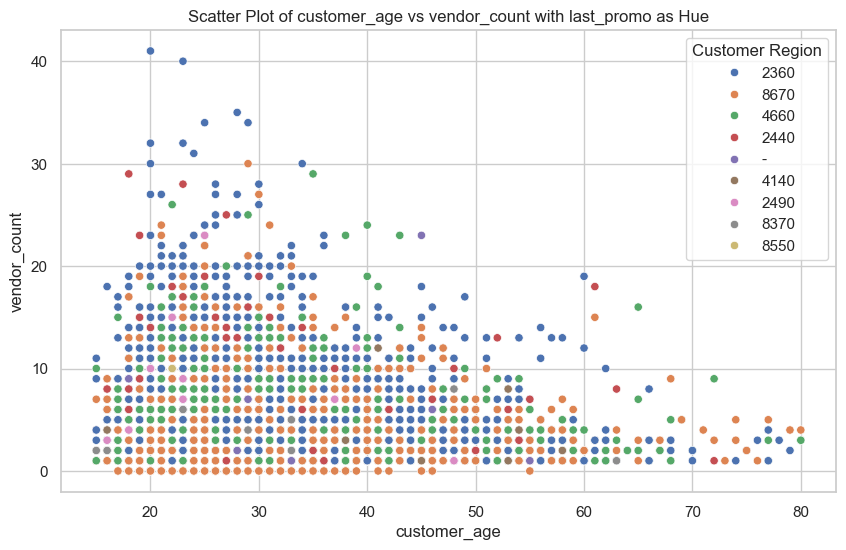

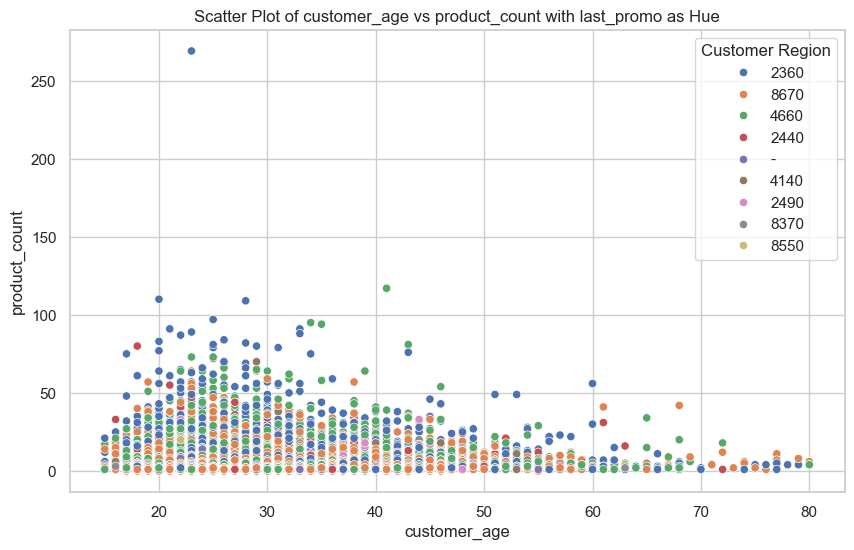

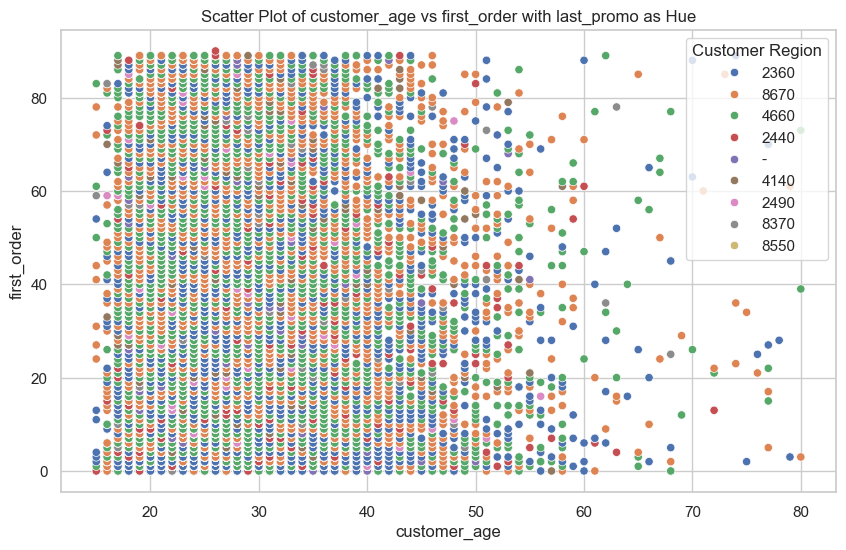

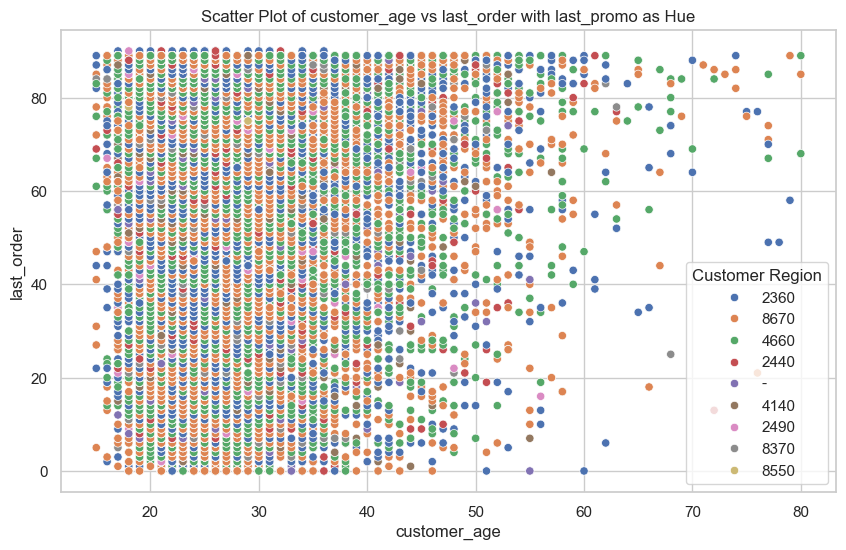

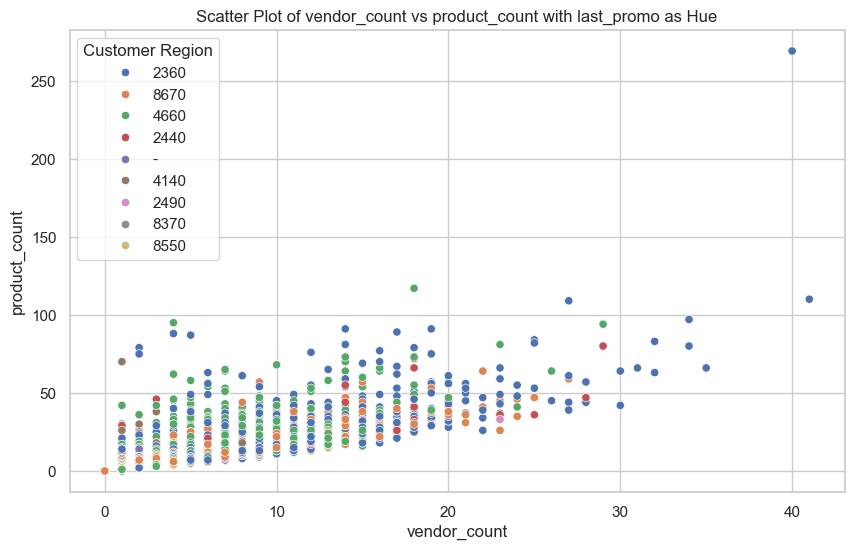

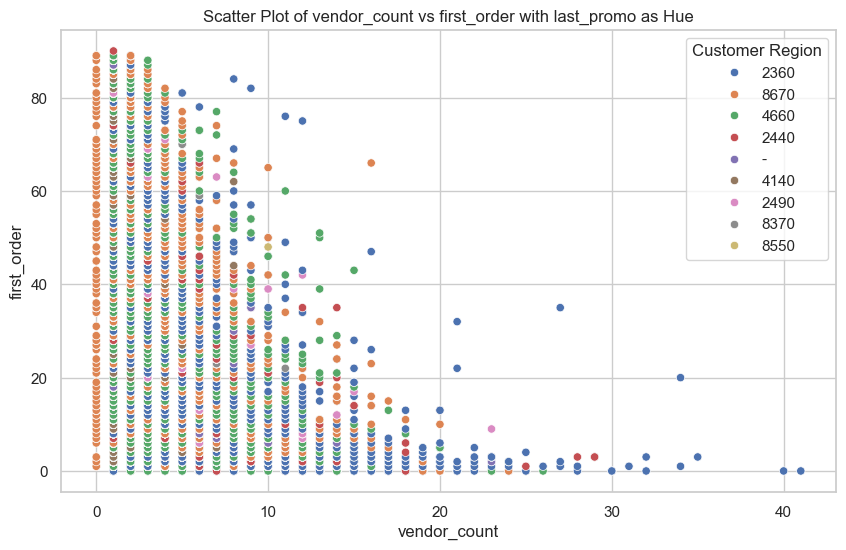

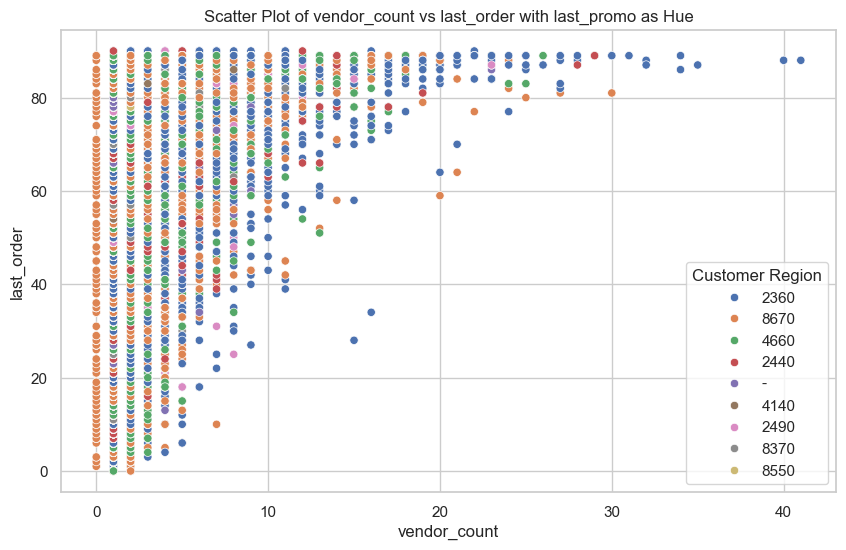

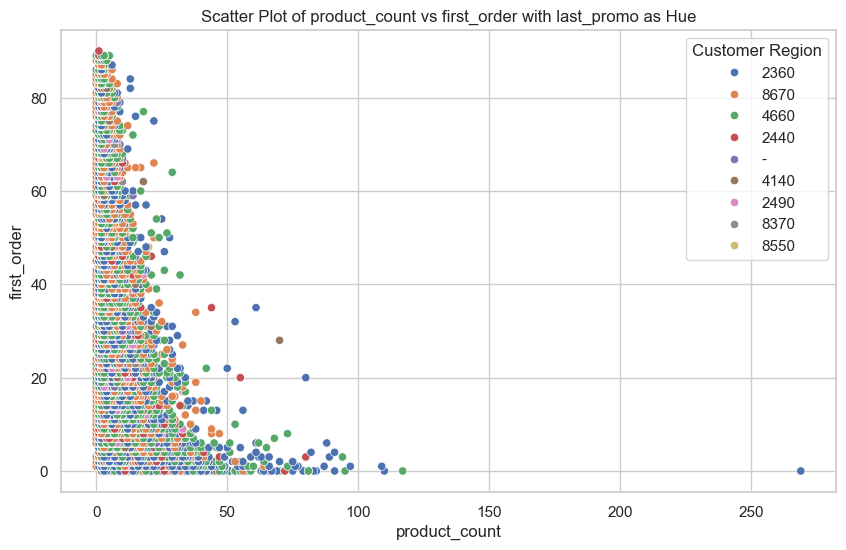

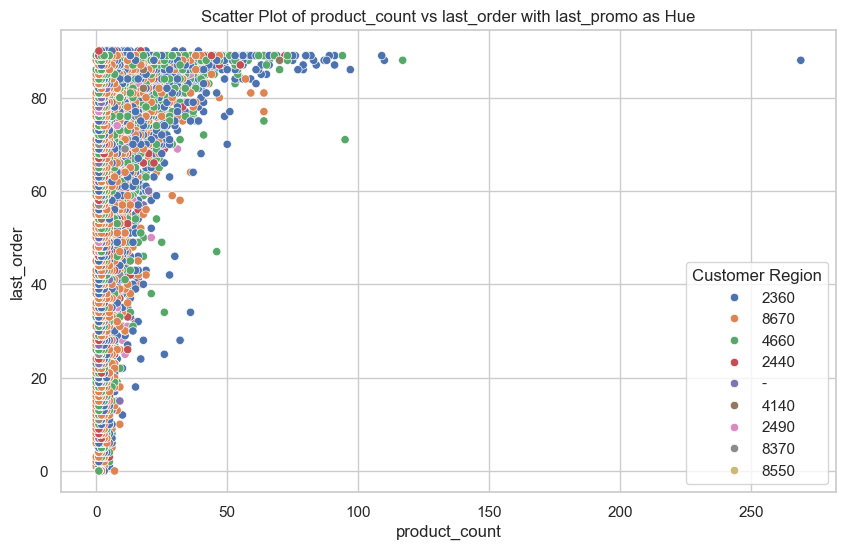

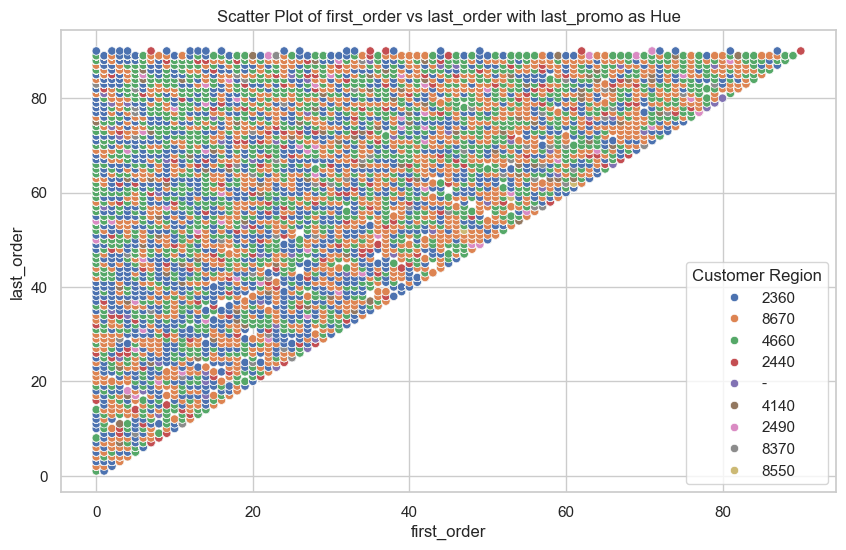

In [147]:
for i in range(len(numeric_pt1)):
    for j in range(i + 1, len(numeric_pt1)):
        plt.figure(figsize=(10, 6))
        sns.scatterplot(data=df, x=numeric_pt1[i], y=numeric_pt1[j], hue='customer_region', palette='deep')

        # Adding titles and labels
        plt.title(f'Scatter Plot of {numeric_pt1[i]} vs {numeric_pt1[j]} with last_promo as Hue')
        plt.xlabel(numeric_pt1[i])
        plt.ylabel(numeric_pt1[j])
        plt.legend(title='Customer Region')
        
        # Show the plot
        plt.show()

### Conclusions
#### Pairwise relationship of Numerical features
- Regarding correlation the variables seem to not be highly correlated. The only 2 variables whose correlation is above 0.8 is vendor_count and product_count (which makes sense if you order from more vendors it is likely that the number of products to be higher).
- When adding the additional features `order_lifetime`, `D_orders` and `H_orders` we have higher correlations amongst the variables.
- Variables `D_orders` and `H_orders` have a mostly perfect correlation, the fact that this variables aren't perfectly correlated regards the missing values in `HR_0`.
- Variables that have a correlation above 0.8 are: `D_orders` and `product_count` (0.95), `H_orders` and `product_count` (0.94), `D_orders` and `product_count` (0.89), `H_orders` and `product_count` (0.88), `product_count` and `vendor_count` (0.85), `D_orders` and `order_lifetime` (0.83), `H_orders` and `order_lifetime` (0.83).
- Other variables worth mentioning that have a correlation above 0.5 but below 0.8 are: `order_lifetime` and `product_count` (0.79), `order_lifetime` and `vendor_count` (0.76), `order_lifetime` and `first_oder` (-0.65), `order_lifetime` and `last_order` (0.6), `D_orders` and `first_oder` (-0.51), `D_orders` and `last_order` (0.51), `H_orders` and `first_oder` (-0.51), `H_orders` and `last_order` (0.51).
- A lot of variables have multidimensional outliers, but there are some that are most extreme / easy to detect that are in varaibles: <br>
a) `product_count` has at least one multidimensional outlier with all columns; <br>
b) `CUI_Asia` has at least one multidimensional outlier with all columns; <br>
c) `CUI_Healthy` and `CUI_Chiken_Dished` present multidimensional outliers; <br>
d) `CUI_Italian`, `CUI_Japonese`, `CUI_Noodle_Dishes` present multidimensional outliers with all variables. <br>
#### Comparing categorical features
- When ploting `is_chain` vs `last_promo` we obtain the following insights:
a) Customers whose value in feature `is_chain` equals 25, 28 or 43 did not utilize the Freebie promotion as their last promotion used; <br>
b) For customers whose value in the `is_chain` feature is one of [27, 31, 33, 38, 39, 42, 44, 45, 48, 54, 56, 61, 63, 65, 67, 80, 81, 83], the last promotion they used was '-' (indicating no discount)."; <br>
c) Customers whose value in the `is_chain` feature is 30 or 35 did not use the Discount promotion as their last promotion; <br>
d) Customers whose value in the `is_chain` feature is 36 or 40 only utilized as their last promotion "-" or Freebie; <br>
e) Customers whose value in the `is_chain` feature is 47 or 73 only utilized Delivery as their last promotion; <br>
f) Customers whose value in the `is_chain` feature is 48 only utilized "-" and Delivery as their last promotion; <br>
g) Customers whose value in the `is_chain` feature is 49 or 75 only utilized Freebie as their last promotion.
- Ploting `last_promo` and `payment_method` do not provide us useful insights, since the percentages in the stacked column chart are very similar.
- The unique relevant insight that from ploting `last_promo` against `customer_region` is that for the region 8550 no customer used the Discount promotion. This region is also the region where we have the lowest customer base whose percentage is really close to 0.
- When ploting `is_chain` vs `payment_method` we obtain the following insights:
a) Customers whose value in the `is_chain` feature is 27, 40 or 43 only paid with their credit card or via digital payment; <br>
b) Customers whose value in the `is_chain` feature is 28, 29 or 33 only paid with their credit card or with cash; <br>
c) Customers whose value in the `is_chain` is 31, 37, 38, 39, 42, 44, 48, 49, 54, 56, 61, 67, 75, 81 or 83 only paid with their credit card; <br>
d) Customers whose value in the `is_chain` is 46, 47, 65, 73 or 80 only paid via digital payment; <br>
e) Customers whose value in the `is_chain` is 63 only paid with cash. <br>
- Ploting `customer_region` against `payment_method` does not provide any relevant insight, since the percentages in the stacked column chart are very similar.
- When ploting `is_chain` vs `customer_region` we obtain the following insights:
a) All values of `is_chain` have customers from the 2360 region (our 3rd region with highest customer base); <br>
b) Customers whose value in the `is_chain` feature is 36, 37, 38, 39, 40, 42, 44, 46, 47, 49, 54, 56, 61, 63, 65, 67, 73, 75, 80, 81 or 83 are from region 2360; <br>
c) Customers whose value in the `is_chain` feature is 33, 35, 48 only have customers from regions 2360 and 4660 (our top 2 and 3 regions based on customer base); <br>
d) Customers from our largest region (8670), in terms of customer base, are only associated with `is_chain` values ranging from 0 to 20, as well as 22, 24, 26, 27, 30, 31, and 32. <br>
#### Comparing categorical variables vs continuous (or discrete) variables
- For orders that occured more recently customers tend to don't use any `last_promo`.
- Customers that made their first order in the early days the majority of them did not use any promotion.
- The most recent the order the more people tend to use credit card as their payment method.
- Customers that made their first order in the early days the majority of them paid with credit card.
- There weren't any more interesting insights to discuss. 

### Conclusions - Summary (This will be removed prior the submission of the work)

### 3.1. Data Content
1. The dataset contains **31888 rows and 56 columns**.
2. `is_chain` is of int64 type but by the data description it seems like a binary variable (but actually it is not - need to ask the professor about this variable).

### 3.2. Missing values
1. There are only missing values in 3 variables (all numeric): **custumer_age (727), first_order (106) and HR_0 (1165)**.
2. There are no rows that have missing values in these 3 columns.
3. The amount of rows that contain at least 1 missing value is: **1968 rows**.

### 3.3. Descriptive Statistics
#### Numeric variables
1. In variable `customer_age` the minimum value is **15** years old, so we have customers that are minors. Considering the GDPR (General Data Protection Regulation), we cannot treat data of minor under 16 without parental consent (we might remove those clients in Data Pre-processing).
2. The average age of our customers is **≈28 years old,** which means the company customers are mainly young adults. 
3. Variables `vendor_count`, `product_count`, `is_chain`, `first_order` have as minimum value 0, which indicate that we may have customers that did not actually make any purchases in the company (so they shouldn't be considered as customers).
4. On average each customer orders **5.668245 items** in a purchase.
5. Asian cuisine is the type of cuisine where people spend on average the most, and is also the one where a customer spent the most money on **(896.71 monetary units)**.
6. Noodle dishes cuisine is on average the type of cuisine costumers spend less monetary units in it. However, Thai cuisine is the type of cuisine where the customer who spend the most on it registered the lowest value when compared with the other types of cuisine. (Basically, Thai cuisine has the lowest maximum value).
7. Friday and Saturday were the days when the highest amount of orders was placed **(20)**. Moreover, Saturday has the highest number of orders than Friday and then any other day of the week.
8. The hour of the day when the most orders were registered was 8 a.m **(52 orders)**.
9. There are no orders that occurred at midnight, since all the values in variable HR_0 equal 0, so this is a univariate variable (that will not help us discriminate into different customer segments).
10. The top 3 hours of the day that registered more orders on average are 5p.m **(0.390962)**, 11 a.m **(0.378167)**, 4p.m **(0.356435)**.
11. Variables `customer_age`, `vendor_count`, `product_count`, `is_chain`, `first_order`, all `CUI ...`, all `DOW ...` and all `HR ...` variables have a great discrepancy between the value in the 75 percentile and the maximum value, which indicates the presence of outliers in the data.
#### Categorical variables
1. Variable `customer_id` has **31875** unique values out of the **31888** clients in the dataset, so this indicates that we may have duplicates in the data (13 duplicates).
2. There are only 9 different customer regions where our customers belong to. Being the most common, the region 8670 with **30.61%** of the customers belonging to it.
3. There are four different promotion types used by customers in the date of their last purchase. The most common one is "-", which likely indicates that no promotion was used. In fact, **52.52%** of customers did not use any promotion.
4. Customers paid their bills with 3 different methods, being Card the most common, with **63.22%** of customers using it as their preferred method for payment.

### 3.4. Incoherences / Some cool stuff we can say about data
1. There were indeed **13 duplicates** in the data, there were removed.
2. From the **31888 customers**, **1436** are new customers, since they have 0 as the value of the first purchase and last purchase.
3. There are **138 customers** that did not spend any money in the company.
4. Those **138 customers** actually didn't order anything. (Probs remove them in Data Pre-processing)
5. There are **442 customers** that belong to region "-" (which clearly is an unknown region)
6. For **52.52%** of the customer's their last promotion used was "-" so maybe we should consider it as NO Promotion used.

### 3.5 Univariate feature exploration
#### Numeric features
1. From our set of features, `customer_age` is the one whose distribution resembles the most, a normal distribution, despite its long tail in the right.
2. After performing the Anderson-Darling to check if the distribution of the variable is Normal, we concluded that for all usual significance levels the distribution is not a normal one. (We strongly reject that hypothesis)
3. Even if we remove the outliers from the distribution, the distribution is not Normal.
4. As expected, while `first order` possesses a right skewed distribution, `last_order` possesses a left skewed distribution (being the only one with this kind of distribution.
5. All other variables have right skewed distributions.
6. The vast majority of our variables possess missing values, the ones that don't have missing values are: `first_order`, `last_order` and `HR_0`.
7. The variable `HR_0` only possesses values equal to 0, which might change in the data pre-processing.
### Categorical features
1. **Warning:** I still have doubts if `is_chain` should be a binary or a categorical variable (like a chain code). Nonetheless, by analysing the bar plot, we can see that the values from 0 to 3 encapsulate **71%** of the customers.
2. The most used promotion was **"Delivery"** (considering "-" as not using a promotion) with **19.7%**, followed by **"Discount"** with **14.1%** of the customers using it and then not using **"Freebie"** with **13.7%**. It seems there is a clear promotion which is mostly adopted by the customers.
3. Regarding the different `Payment_methods` the most preferred one is **"Card"** with **63.2%** indicating that the majority of our customers prefer to pay their build with their credit cards.
4. **88.3%** of our customers are located in 3 of the 8 regions, which indicates that our customer base is highly concentrated in just **37.5%** of the possible regions. Focusing markerting on the other small represented regions can be a good solution to increase the company customer base in these regions.
5. The regions where our customer base is the largest are: region 8670 with **30.6%** of the customers belonging to this region, region 4660 with **30%** of the customers belonging to this region and region 2360 with **27.7%** of the customers belonging to this region.

### 3.6. Multivariate Analysis
`order_lifetime`

1. We have a total of **7187 customers** that only ordered once in the company.
2. This variable has a right tail distribution that is less skewed than the `first_order`.
3. By not considering the customers that only made a purchase in the company, the order_lifetime follows a distribution that is more approximate to an uniform distribution, only registering a significant drop if the value is above 80.
4. The boxplot of this variable resembles a more or symetric distribution and does not present outliers.

`D_orders` and `H_orders`

1. The values in `D_orders` and `H_orders` are not equal, despite the fact they should be.
2. This difference is due to the missing values obversed on variable `HR_0`.
3. The distribution of these variables as expected conserve the same right skeweness as all the variables `DOW_` and `HR_`.
4. This variable also conserve the outliers and seem to have more outliers than the individual features.
### 3.7. Multivariate Analysis 
#### Pairwise relationship of Numerical features
1. Regarding correlation the variables seem to not be highly correlated. The only 2 variables whose correlation is above 0.8 is vendor_count and product_count (which makes sense if you order from more vendors it is likely that the number of products to be higher).
2. When adding the additional features `order_lifetime`, `D_orders` and `H_orders` we have higher correlations amongst the variables.
3. Variables `D_orders` and `H_orders` have a mostly perfect correlation, the fact that this variables aren't perfectly correlated regards the missing values in `HR_0`.
4. Variables that have a correlation above 0.8 are: `D_orders` and `product_count` (0.95), `H_orders` and `product_count` (0.94), `D_orders` and `product_count` (0.89), `H_orders` and `product_count` (0.88), `product_count` and `vendor_count` (0.85), `D_orders` and `order_lifetime` (0.83), `H_orders` and `order_lifetime` (0.83).
5. Other variables worth mentioning that have a correlation above 0.5 but below 0.8 are: `order_lifetime` and `product_count` (0.79), `order_lifetime` and `vendor_count` (0.76), `order_lifetime` and `first_oder` (-0.65), `order_lifetime` and `last_order` (0.6), `D_orders` and `first_oder` (-0.51), `D_orders` and `last_order` (0.51), `H_orders` and `first_oder` (-0.51), `H_orders` and `last_order` (0.51).
6. A lot of variables have multidimensional outliers, but there are some that are most extreme / easy to detect that are in varaibles: <br>
a) `product_count` has at least one multidimensional outlier with all columns; <br>
b) `CUI_Asia` has at least one multidimensional outlier with all columns; <br>
c) `CUI_Healthy` and `CUI_Chiken_Dished` present multidimensional outliers; <br>
d) `CUI_Italian`, `CUI_Japonese`, `CUI_Noodle_Dishes` present multidimensional outliers with all variables. <br>
#### Comparing categorical features
1. When ploting `is_chain` vs `last_promo` we obtain the following insights:
a) Customers whose value in feature `is_chain` equals 25, 28 or 43 did not utilize the Freebie promotion as their last promotion used; <br>
b) For customers whose value in the `is_chain` feature is one of [27, 31, 33, 38, 39, 42, 44, 45, 48, 54, 56, 61, 63, 65, 67, 80, 81, 83], the last promotion they used was '-' (indicating no discount)."; <br>
c) Customers whose value in the `is_chain` feature is 30 or 35 did not use the Discount promotion as their last promotion; <br>
d) Customers whose value in the `is_chain` feature is 36 or 40 only utilized as their last promotion "-" or Freebie; <br>
e) Customers whose value in the `is_chain` feature is 47 or 73 only utilized Delivery as their last promotion; <br>
f) Customers whose value in the `is_chain` feature is 48 only utilized "-" and Delivery as their last promotion; <br>
g) Customers whose value in the `is_chain` feature is 49 or 75 only utilized Freebie as their last promotion. <br>
2. Ploting `last_promo` and `payment_method` do not provide us useful insights, since the percentages in the stacked column chart are very similar.
3. The unique relevant insight that from ploting `last_promo` against `customer_region` is that for the region 8550 no customer used the Discount promotion. This region is also the region where we have the lowest customer base whose percentage is really close to 0.
4. When ploting `is_chain` vs `payment_method` we obtain the following insights:
a) Customers whose value in the `is_chain` feature is 27, 40 or 43 only paid with their credit card or via digital payment; <br>
b) Customers whose value in the `is_chain` feature is 28, 29 or 33 only paid with their credit card or with cash; <br>
c) Customers whose value in the `is_chain` is 31, 37, 38, 39, 42, 44, 48, 49, 54, 56, 61, 67, 75, 81 or 83 only paid with their credit card; <br>
d) Customers whose value in the `is_chain` is 46, 47, 65, 73 or 80 only paid via digital payment; <br>
e) Customers whose value in the `is_chain` is 63 only paid with cash. <br>
5. Ploting `customer_region` against `payment_method` does not provide any relevant insight, since the percentages in the stacked column chart are very similar. <br>
6. When ploting `is_chain` vs `customer_region` we obtain the following insights:
a) All values of `is_chain` have customers from the 2360 region (our 3rd region with highest customer base); <br>
b) Customers whose value in the `is_chain` feature is 36, 37, 38, 39, 40, 42, 44, 46, 47, 49, 54, 56, 61, 63, 65, 67, 73, 75, 80, 81 or 83 are from region 2360; <br>
c) Customers whose value in the `is_chain` feature is 33, 35, 48 only have customers from regions 2360 and 4660 (our top 2 and 3 regions based on customer base); <br>
d) Customers from our largest region (8670), in terms of customer base, are only associated with `is_chain` values ranging from 0 to 20, as well as 22, 24, 26, 27, 30, 31, and 32. <br>
#### Comparing categorical variables vs continuous (or discrete) variables
1. For orders that occured more recently customers tend to don't use any `last_promo`.
2. Customers that made their first order in the early days the majority of them did not use any promotion.
3. The most recent the order the more people tend to use credit card as their payment method.
4. Customers that made their first order in the early days the majority of them paid with credit card.
5. There weren't any more interesting insights to discuss. 